## **Image Classification with deep learning  algorithm**

In [1]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!pip install keras-tuner --upgrade

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.1/176.1 kB 18.6 MB/s eta 0:00:00


In [3]:
pip install gradio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 63.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 73.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 9.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 287.9/287.9 kB 40.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.3/75.3 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 30.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.5/50.5 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.2/137.2 kB 21.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.9/129.9 

In [4]:
import os, shutil, tarfile, requests

import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from tensorboard import notebook
import keras.utils as image
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Dense
from keras.utils.vis_utils import plot_model
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from kerastuner import RandomSearch
from kerastuner.engine.hyperparameters import HyperParameters
import kerastuner as kt

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import cv2
import timeit
from google.colab.patches import cv2_imshow
import math
from PIL import Image
from tqdm import tqdm
import matplotlib as mpl
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

keras.backend.clear_session()
np.random.seed(42)
tf.random.set_seed(42)


<ipython-input-4-4bfab29ca426>:24: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import RandomSearch


## Image Preview

Let's look an image of a dog

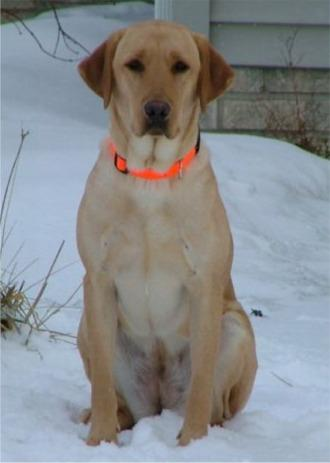

(463, 330, 3)

In [5]:

labrador = "/content/drive/MyDrive/Colab_Notebooks/data/Images/n02099712-Labrador_retriever/n02099712_8719.jpg"

dog = cv2.imread(labrador)
cv2_imshow(dog)
dog.shape
     


In [6]:
# Let's look at the classe number of dogs
image_path="/content/drive/MyDrive/Colab_Notebooks/data/Images/"
dog_cat = os.listdir(image_path)
print(len(dog_cat))
print(dog_cat)


120
['n02113023-Pembroke', 'n02113186-Cardigan', 'n02113624-toy_poodle', 'n02113712-miniature_poodle', 'n02113799-standard_poodle', 'n02113978-Mexican_hairless', 'n02115641-dingo', 'n02115913-dhole', 'n02116738-African_hunting_dog', 'n02089973-English_foxhound', 'n02091635-otterhound', 'n02105855-Shetland_sheepdog', 'n02108915-French_bulldog', 'n02085620-Chihuahua', 'n02085782-Japanese_spaniel', 'n02085936-Maltese_dog', 'n02086079-Pekinese', 'n02086240-Shih-Tzu', 'n02086646-Blenheim_spaniel', 'n02086910-papillon', 'n02087046-toy_terrier', 'n02087394-Rhodesian_ridgeback', 'n02088094-Afghan_hound', 'n02088238-basset', 'n02088364-beagle', 'n02088466-bloodhound', 'n02088632-bluetick', 'n02089078-black-and-tan_coonhound', 'n02089867-Walker_hound', 'n02090379-redbone', 'n02090622-borzoi', 'n02090721-Irish_wolfhound', 'n02091032-Italian_greyhound', 'n02091134-whippet', 'n02091244-Ibizan_hound', 'n02091467-Norwegian_elkhound', 'n02091831-Saluki', 'n02092002-Scottish_deerhound', 'n02092339-Weim

In [7]:
# Dictionary to store the count of images for each label
image_count={}

# List to store image data
data= []

# Iterate over the dog_cat list and process each category
for i, cat in tqdm(enumerate(dog_cat)):
    class_folder = os.path.join(image_path, cat)
    label = cat.split('-')[1]
    image_count[label] = []

    # Iterate over the files in the class folder
    for path in os.listdir(class_folder):
        # Append the label to the image_count dictionary
        image_count[label].append(label)
        # Add the image data (path, index, label) to the data list
        data.append(['{}/{}'.format(cat, path), i, label])

120it [00:36,  3.33it/s]


In [8]:
#show image count
for key, value in image_count.items():
    print('{0} -> {1}'.format(key, len(value)))

Pembroke -> 181
Cardigan -> 155
toy_poodle -> 151
miniature_poodle -> 155
standard_poodle -> 159
Mexican_hairless -> 155
dingo -> 156
dhole -> 150
African_hunting_dog -> 169
English_foxhound -> 157
otterhound -> 151
Shetland_sheepdog -> 157
French_bulldog -> 159
Chihuahua -> 152
Japanese_spaniel -> 185
Maltese_dog -> 252
Pekinese -> 149
Shih -> 214
Blenheim_spaniel -> 188
papillon -> 196
toy_terrier -> 172
Rhodesian_ridgeback -> 172
Afghan_hound -> 239
basset -> 175
beagle -> 195
bloodhound -> 187
bluetick -> 171
black -> 159
Walker_hound -> 153
redbone -> 148
borzoi -> 151
Irish_wolfhound -> 218
Italian_greyhound -> 182
whippet -> 187
Ibizan_hound -> 188
Norwegian_elkhound -> 196
Saluki -> 200
Scottish_deerhound -> 232
Weimaraner -> 160
Staffordshire_bullterrier -> 155
American_Staffordshire_terrier -> 164
Bedlington_terrier -> 182
Border_terrier -> 172
Kerry_blue_terrier -> 179
Irish_terrier -> 169
Norfolk_terrier -> 172
Norwich_terrier -> 185
Yorkshire_terrier -> 164
wire -> 157
Lak

In [9]:
#create a dataframe
dog_df = pd.DataFrame(data, columns=['file', 'id', 'label'])
print(dog_df.shape)
dog_df.head()

(20580, 3)


,file,id,label
0,n02113023-Pembroke/n02113023_12192.jpg,0,Pembroke
1,n02113023-Pembroke/n02113023_11397.jpg,0,Pembroke
2,n02113023-Pembroke/n02113023_11091.jpg,0,Pembroke
3,n02113023-Pembroke/n02113023_1136.jpg,0,Pembroke
4,n02113023-Pembroke/n02113023_1144.jpg,0,Pembroke


# Image Preprocessing

### Image visualization

In [10]:
def show_images_classes(directory_path: str, class_name: str, num_samples: int):
    """
    Display the first n images of a subdirectory under the given root directory.

    Parameters:
    directory_path (str): The path to the root directory containing the subdirectory with images.
    class_name (str): The name of the subdirectory with images.
    num_samples (int): The number of images to display.
    """
    # Create subplots to display the images
    fig, ax = plt.subplots(nrows=1, ncols=num_samples, figsize=(20, 5))
    fig.suptitle("{}".format(class_name.split("-")[1]), y=1.08, fontsize=16, fontweight='bold')
    fig.patch.set_facecolor('#F8F8FF')

    # Get the list of image names in the subdirectory
    images = os.listdir(os.path.join(directory_path, class_name))[:num_samples]

    # Display each image
    for i, image_name in enumerate(images):
        image_path = os.path.join(directory_path, class_name, image_name)
        image = mpimg.imread(image_path)
        ax[i].imshow(image)
        ax[i].axis('off')

    plt.show()

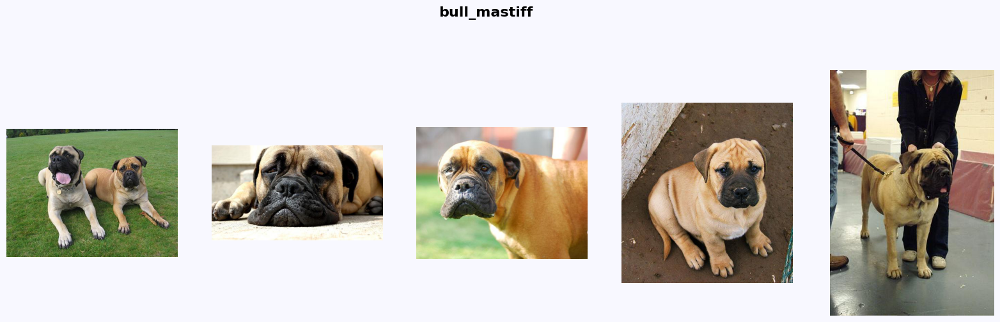

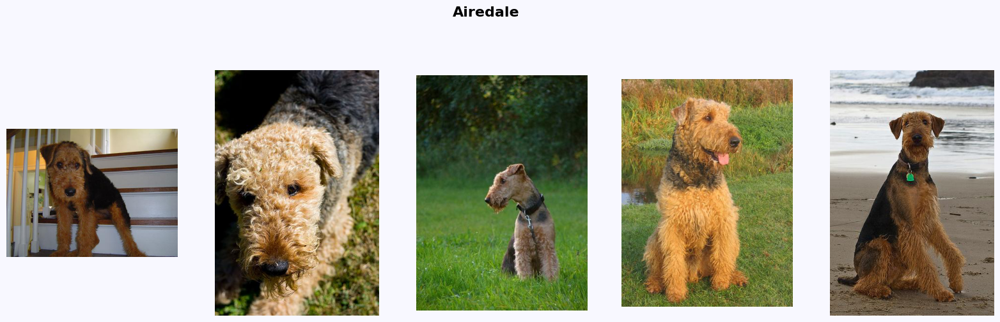

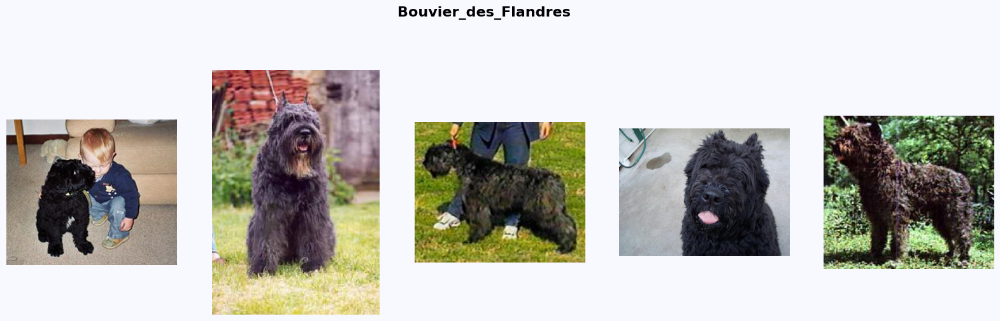

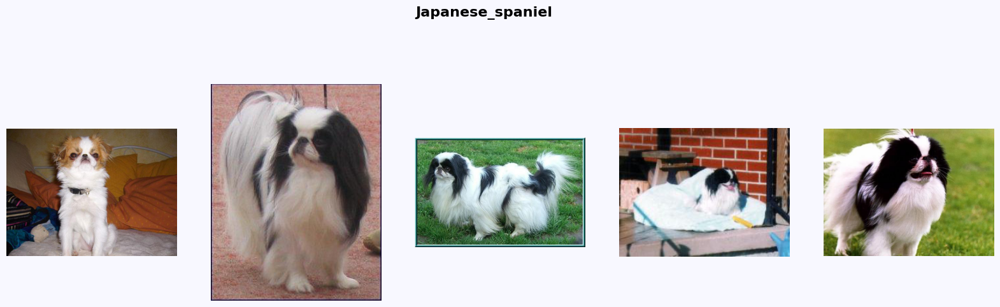

In [11]:
for i in np.random.randint(0, len(dog_cat), size=4):
    show_images_classes(image_path, dog_cat[i], 5)

## Image Transform

### Image resizing

In [12]:
img = dog_df['file'][np.random.randint(400)]
lab = dog_df["label"][np.random.randint(400)]
print (img)
print(lab)

n02113023-Pembroke/n02113023_4544.jpg
Pembroke


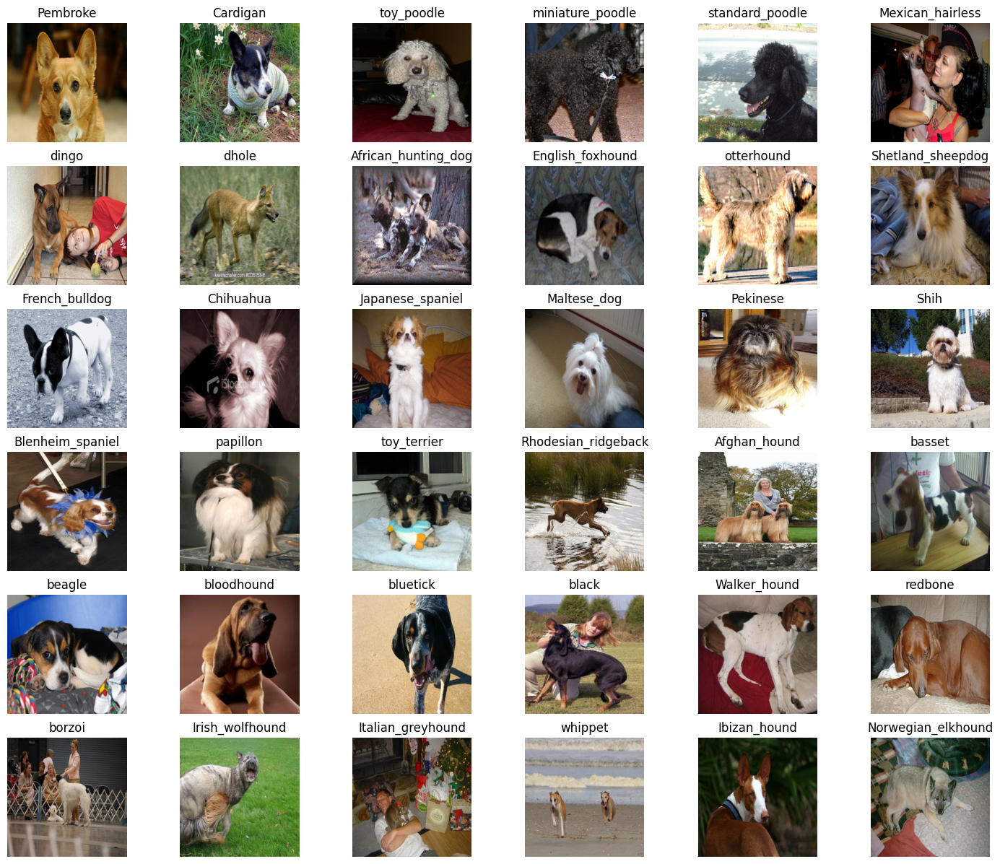

In [13]:
images = np.array([])
categories = np.array([])   
width, height = 224, 224
plt.figure(figsize=(18,15))
i = 1
for dog_path in dog_cat:
    dogs_image = os.listdir(image_path + dog_path)
    cat = dog_path.split('-')[1]
    j = 0
    for dog in dogs_image:
        dog_image = os.path.join(image_path, dog_path, dog)
        images = np.append(images, dog_image)
        categories = np.append(categories, cat)
        if i <= 36 and j == 0:
            img = Image.open(dog_image) 
            img_resized = img.resize((width, height))
            plt.subplot(6, 6, i)
            plt.axis('off')
            plt.title(cat)
            plt.imshow(img_resized)
            i = i + 1
            j = j + 1
plt.show()

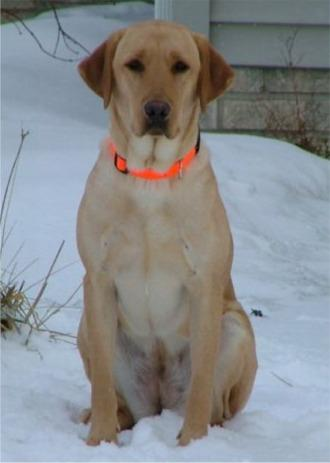

In [14]:
# Set desired dimensions for the resized image
height, width = 250, 250

# Load image using cv2.imread()
img_test = cv2.imread(labrador)
cv2_imshow(img_test)
# Resize image using cv2.resize()
resized_img = cv2.resize(img_test, (width, height), interpolation=cv2.INTER_LINEAR)


### Image whitening

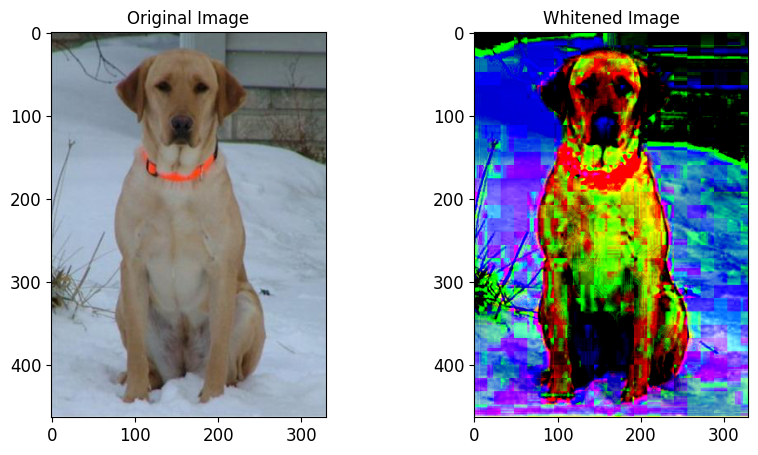

In [15]:
# Load image
img = plt.imread(labrador)


# Flatten image to 2D array
img_flat = img.reshape(-1, 3)

# Calculate mean and covariance of pixel values
mean = np.mean(img_flat, axis=0)
cov = np.cov(img_flat, rowvar=False)

# Perform whitening
eigenvalues, eigenvectors = np.linalg.eigh(cov)
whitened = (eigenvectors @ np.diag(eigenvalues**-0.5) @ eigenvectors.T) @ (img_flat - mean).T
whitened = whitened.T.reshape(img.shape)

# Plot original and whitened images side by side
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(img)
ax[0].set_title('Original Image')
ax[1].imshow(whitened)
ax[1].set_title('Whitened Image')
plt.show()


### Image cropping

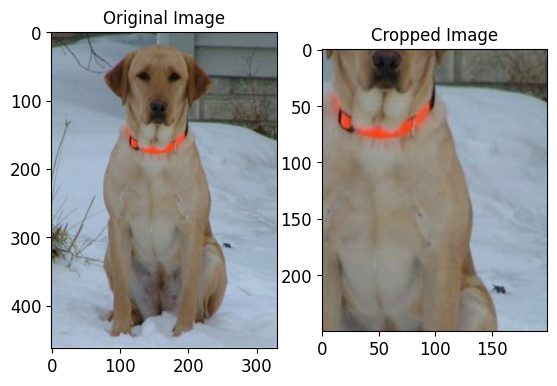

In [16]:
# Load the image
dog = cv2.imread(labrador)

# Define the region of interest (ROI) to crop
x, y = 100, 100
w, h = 200, 250
roi = dog[y:y+h, x:x+w]

# Display the original and cropped image
fig, axs = plt.subplots(1, 2)
axs[0].imshow(cv2.cvtColor(dog, cv2.COLOR_BGR2RGB))
axs[0].set_title('Original Image')
axs[1].imshow(cv2.cvtColor(roi, cv2.COLOR_BGR2RGB))
axs[1].set_title('Cropped Image')
plt.show()


### Image color transform,  Equalization

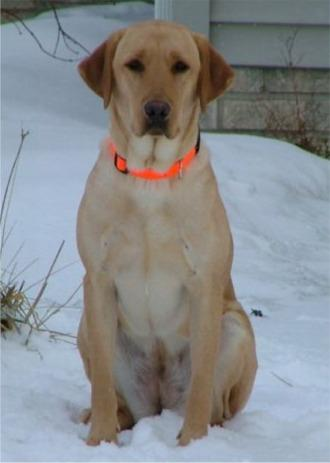

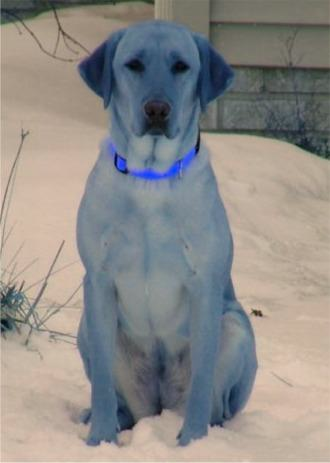

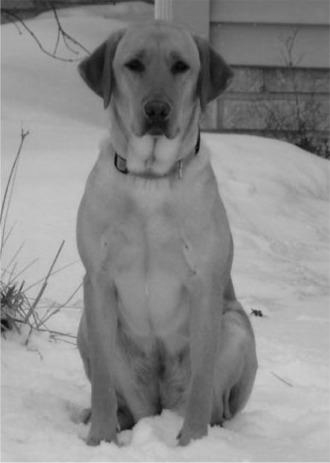

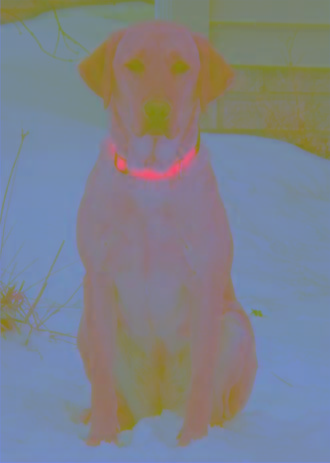

In [17]:
# Convert the image to RGB color space
img_RGB = cv2.cvtColor(img_test, cv2.COLOR_BGR2RGB)

# Convert the image to grayscale
img_grayscale = cv2.cvtColor(img_test, cv2.COLOR_RGB2GRAY)

# Convert the image to YUV color space
img_YUV = cv2.cvtColor(img_test, cv2.COLOR_BGR2YUV)


cv2_imshow(img_test)
cv2_imshow(img_RGB)
cv2_imshow(img_grayscale)
cv2_imshow(img_YUV)

cv2.waitKey(0)
cv2.destroyAllWindows()

      Original Image                 RGB Image                 Grayscale Image                 YUV Image


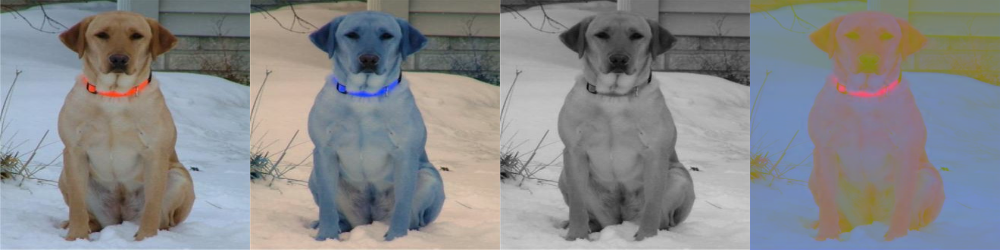

In [18]:
from google.colab.patches import cv2_imshow
resized_img = cv2.resize(img_test, (width, height), interpolation=cv2.INTER_LINEAR)


# Convert the image to RGB color space
img_RGB = cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB)


# Convert the image to grayscale
img_grayscale = cv2.cvtColor(resized_img, cv2.COLOR_RGB2GRAY)
img_grayscale = cv2.cvtColor(img_grayscale, cv2.COLOR_GRAY2RGB)

# Convert the image to YUV color space
img_YUV = cv2.cvtColor(resized_img, cv2.COLOR_BGR2YUV)
#img_YUV = cv2.cvtColor(resized_img, cv2.COLOR_YUV2RGB)

# Resize the images to the same size
#img_RGB = cv2.resize(img_RGB, (img_grayscale.shape[1], img_grayscale.shape[0]))
#img_YUV = cv2.resize(img_YUV, (img_grayscale.shape[1], img_grayscale.shape[0]))
#img_resized = cv2.resize(img_test, (img_grayscale.shape[1], img_grayscale.shape[0]))
# Concatenate the RGB, grayscale, and YUV images horizontally
img_concat = cv2.hconcat([resized_img, img_RGB, img_grayscale, img_YUV])

# Display the concatenated image using cv2_imshow
#cv2.imshow("Concatenated Images", img_concat)
print(" "*5, "Original Image"," "*15,  "RGB Image", " "*15, "Grayscale Image", " "*15, "YUV Image")
cv2_imshow(img_concat)



In [19]:
img_RGB

array([[[107, 112, 105],
        [ 78,  83,  76],
        [ 81,  86,  79],
        ...,
        [103, 117, 120],
        [103, 116, 121],
        [108, 121, 127]],

       [[106, 111, 104],
        [ 76,  81,  74],
        [ 79,  84,  77],
        ...,
        [100, 114, 117],
        [100, 113, 118],
        [105, 118, 124]],

       [[108, 110, 102],
        [ 75,  78,  69],
        [ 78,  81,  72],
        ...,
        [102, 116, 119],
        [102, 115, 120],
        [107, 120, 126]],

       ...,

       [[188, 203, 226],
        [175, 190, 213],
        [176, 191, 214],
        ...,
        [166, 180, 196],
        [166, 180, 196],
        [168, 181, 197]],

       [[188, 203, 224],
        [176, 191, 213],
        [179, 194, 215],
        ...,
        [165, 178, 194],
        [166, 179, 195],
        [169, 182, 198]],

       [[201, 217, 236],
        [191, 206, 226],
        [195, 210, 229],
        ...,
        [185, 198, 214],
        [184, 197, 213],
        [185, 197, 213]]

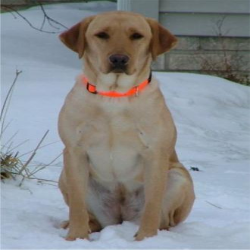

In [20]:
cv2_imshow(resized_img)

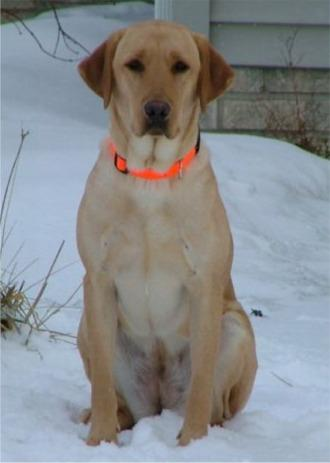

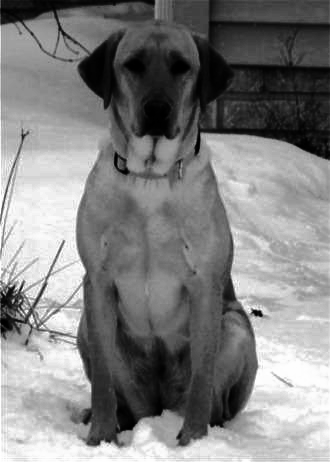

In [21]:
# Load the image
img = cv2.imread(labrador)

# Convert the image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Apply histogram equalization
img_eq = cv2.equalizeHist(gray)

# Display the original and equalized images
cv2_imshow(img)
cv2_imshow(img_eq)


In [22]:
def plot_histogram(init_img, convert_img):
    """Plot the histograms for the initial and converted images.

    Args:
        init_img (tuple): Tuple containing the title and the initial OpenCV image.
        convert_img (tuple): Tuple containing the title and the converted OpenCV image.
    """
    # Compute the histograms
    init_hist, _ = np.histogram(init_img[1].copy().flatten(), 256, [0, 256])
    convert_hist, _ = np.histogram(convert_img[1].flatten(), 256, [0, 256])

    # Compute the cumulative distribution functions
    init_cdf = init_hist.cumsum()
    init_cdf_normalized = init_cdf * float(init_hist.max()) / init_cdf.max()
    convert_cdf = convert_hist.cumsum()
    convert_cdf_normalized = convert_cdf * float(convert_hist.max()) / convert_cdf.max()

    # Plot the histograms and cumulative distribution functions
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(25, 6))
    ax[0].imshow(init_img[1])
    ax[0].set_title(init_img[0], color="#343434")
    ax[1].imshow(convert_img[1])
    ax[1].set_title(convert_img[0], color="#343434")
    ax[2].plot(init_cdf_normalized, color='r', alpha=.7, linestyle='--')
    ax[2].plot(convert_cdf_normalized, color='b', alpha=.7, linestyle='--')
    ax[2].hist(init_img[1].flatten(), 256, [0, 256], color='r', alpha=.5)
    ax[2].hist(convert_img[1].flatten(), 256, [0, 256], color='b', alpha=.5)
    ax[2].set_xlim([0, 256])
    ax[2].legend(('Initial CDF', 'Converted CDF', 'Initial Histogram', 'Converted Histogram'), loc='upper left')
    ax[2].set_title('Histogram and Cumulative Distribution for Test Image', color="#343434")
    fig.suptitle("Histogram and Cumulative Distribution for Test Image", color="black", fontsize=22, y=.98)
    plt.show()
    print(init_img[1])

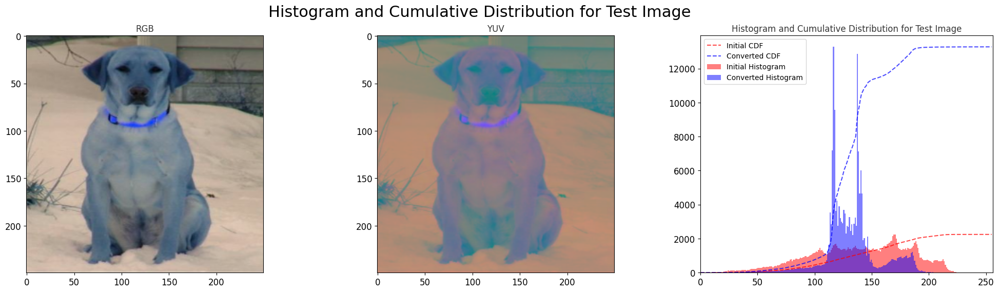

[[[105 112 107]
  [ 76  83  78]
  [ 79  86  81]
  ...
  [120 117 103]
  [121 116 103]
  [127 121 108]]

 [[104 111 106]
  [ 74  81  76]
  [ 77  84  79]
  ...
  [117 114 100]
  [118 113 100]
  [124 118 105]]

 [[102 110 108]
  [ 69  78  75]
  [ 72  81  78]
  ...
  [119 116 102]
  [120 115 102]
  [126 120 107]]

 ...

 [[226 203 188]
  [213 190 175]
  [214 191 176]
  ...
  [196 180 166]
  [196 180 166]
  [197 181 168]]

 [[224 203 188]
  [213 191 176]
  [215 194 179]
  ...
  [194 178 165]
  [195 179 166]
  [198 182 169]]

 [[236 217 201]
  [226 206 191]
  [229 210 195]
  ...
  [214 198 185]
  [213 197 184]
  [213 197 185]]]


In [23]:
plot_histogram(("RGB", resized_img), ("YUV", img_YUV))

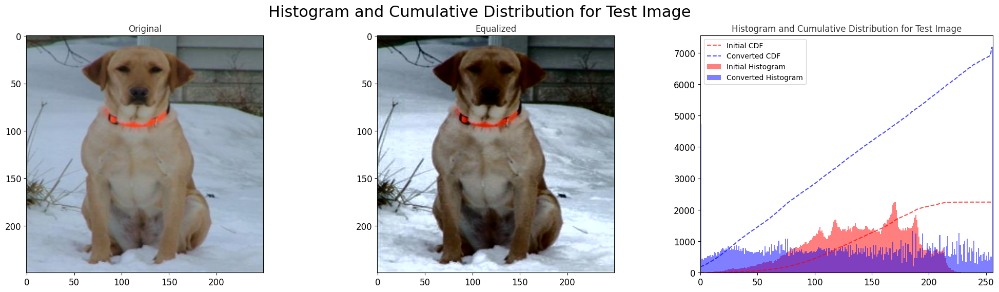

[[[107 112 105]
  [ 78  83  76]
  [ 81  86  79]
  ...
  [103 117 120]
  [103 116 121]
  [108 121 127]]

 [[106 111 104]
  [ 76  81  74]
  [ 79  84  77]
  ...
  [100 114 117]
  [100 113 118]
  [105 118 124]]

 [[108 110 102]
  [ 75  78  69]
  [ 78  81  72]
  ...
  [102 116 119]
  [102 115 120]
  [107 120 126]]

 ...

 [[188 203 226]
  [175 190 213]
  [176 191 214]
  ...
  [166 180 196]
  [166 180 196]
  [168 181 197]]

 [[188 203 224]
  [176 191 213]
  [179 194 215]
  ...
  [165 178 194]
  [166 179 195]
  [169 182 198]]

 [[201 217 236]
  [191 206 226]
  [195 210 229]
  ...
  [185 198 214]
  [184 197 213]
  [185 197 213]]]


In [24]:
#Equalize the Y channel of the YUV image

img_YUV[:,:,0] = cv2.equalizeHist(img_YUV[:,:,0])
#Convert the equalized YUV image to RGB format

img_equ = cv2.cvtColor(img_YUV, cv2.COLOR_YUV2RGB)
#Plot the initial RGB image and the equalized RGB image with histogram

plot_histogram(("Original", img_RGB), ("Equalized", img_equ))


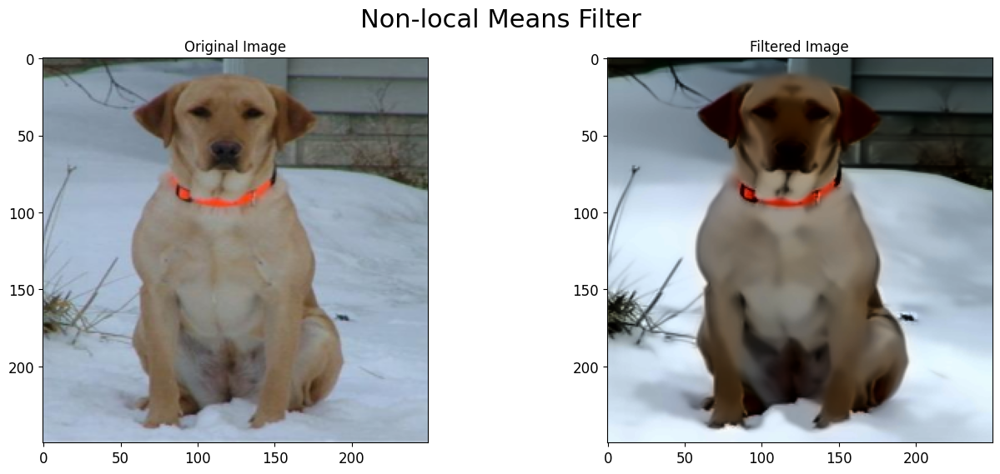

In [25]:
#Apply non-local means filter on test img

dst_img = cv2.fastNlMeansDenoisingColored(
src=img_equ,
dst=None,
h=10,
hColor=10,
templateWindowSize=7,
searchWindowSize=21)

#Show both img
fig = plt.figure(figsize=(16,6))
plt.subplot(1, 2, 1)
plt.imshow(img_RGB)
plt.title("Original Image")
plt.subplot(1, 2, 2)
plt.imshow(dst_img)
plt.title("Filtered Image")
plt.suptitle("Non-local Means Filter",
color="black",
fontsize=22, y=.98)
plt.show()

### Data Augmentation

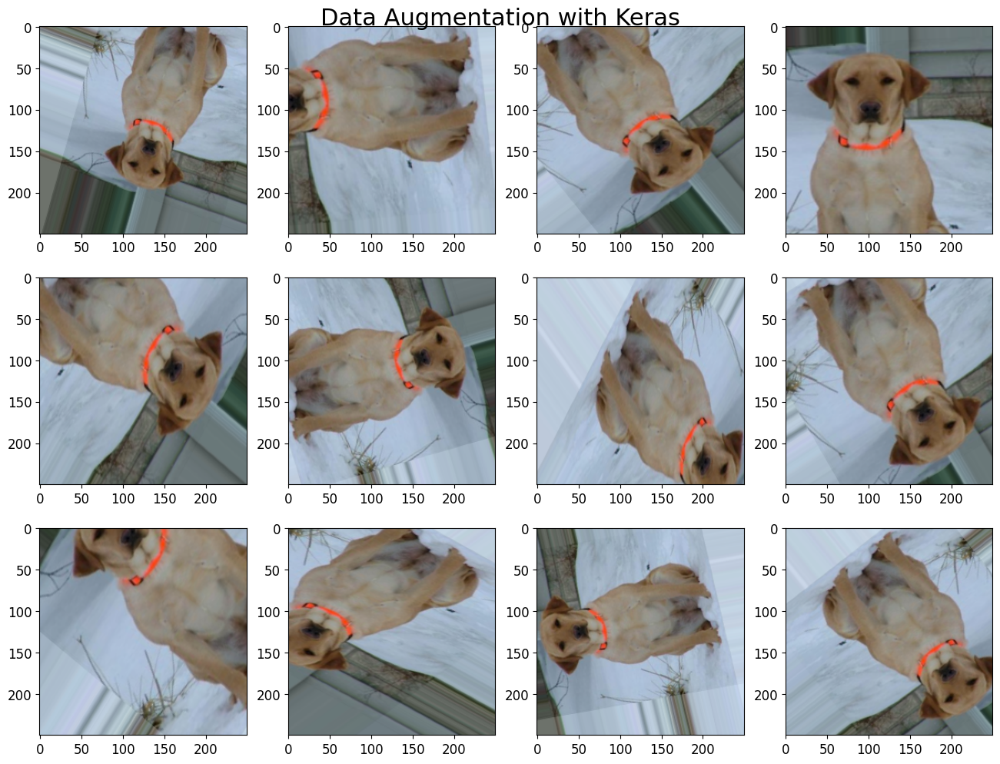

In [26]:
# Initialize Data Generator Keras
augmented_datagen = ImageDataGenerator(
    rotation_range=90, 
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.3,
    vertical_flip=True,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2)

# Convert test img to array
x = image.img_to_array(img_RGB)
x = x.reshape((1,) + x.shape)

# Generate and show augmented images
i = 0
fig, axs = plt.subplots(3, 4, figsize=(16, 12))
for batch in augmented_datagen.flow(x, batch_size=1):
    axs[i // 4][i % 4].imshow(image.array_to_img(batch[0]))
    i += 1
    if i % 12 == 0:
        break

plt.suptitle("Data Augmentation with Keras",
             color="black", 
             fontsize=22, y=.90)
plt.show()

##  Categories selection and preprocessing application

### Image preprocessing

In [27]:

def preprocessing_cnn(directories, img_width, img_height):
    """
    Preprocessing of images in order to integrate them into a 
    convolutional neural network. This includes resizing, equalization,
    denoising, and conversion to arrays. Labels are created simultaneously.

    Parameters:
        directories (list): List of directories to be processed.
        img_width (int): Width of the image to be resized to.
        img_height (int): Height of the image to be resized to.
    
    Returns:
        Tuple: A tuple containing a list of preprocessed images and a list of labels.
    """
    img_list = []
    labels = []
    
    for index, cat in enumerate(directories):
        for image_name in os.listdir(image_path + "/" + cat):
            # Read image
            img = cv2.imread(image_path + "/" + cat + "/" + image_name)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            # Resize image
            dim = (img_width, img_height)
            img = cv2.resize(img, dim, interpolation=cv2.INTER_LINEAR)

            # Equalization
            img_yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
            img_yuv[:, :, 0] = cv2.equalizeHist(img_yuv[:, :, 0])
            img_equ = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)

            # Apply denoising
            dst_img = cv2.fastNlMeansDenoisingColored(
                src=img_equ,
                dst=None,
                h=10,
                hColor=10,
                templateWindowSize=7,
                searchWindowSize=21)

            # Convert image to array
            img_array = image.img_to_array(dst_img)

            # Append lists of labels and images
            img_list.append(np.array(img_array))
            labels.append(cat.split("-")[1])
    
    return img_list, labels

In [28]:
dog_cat

['n02113023-Pembroke',
 'n02113186-Cardigan',
 'n02113624-toy_poodle',
 'n02113712-miniature_poodle',
 'n02113799-standard_poodle',
 'n02113978-Mexican_hairless',
 'n02115641-dingo',
 'n02115913-dhole',
 'n02116738-African_hunting_dog',
 'n02089973-English_foxhound',
 'n02091635-otterhound',
 'n02105855-Shetland_sheepdog',
 'n02108915-French_bulldog',
 'n02085620-Chihuahua',
 'n02085782-Japanese_spaniel',
 'n02085936-Maltese_dog',
 'n02086079-Pekinese',
 'n02086240-Shih-Tzu',
 'n02086646-Blenheim_spaniel',
 'n02086910-papillon',
 'n02087046-toy_terrier',
 'n02087394-Rhodesian_ridgeback',
 'n02088094-Afghan_hound',
 'n02088238-basset',
 'n02088364-beagle',
 'n02088466-bloodhound',
 'n02088632-bluetick',
 'n02089078-black-and-tan_coonhound',
 'n02089867-Walker_hound',
 'n02090379-redbone',
 'n02090622-borzoi',
 'n02090721-Irish_wolfhound',
 'n02091032-Italian_greyhound',
 'n02091134-whippet',
 'n02091244-Ibizan_hound',
 'n02091467-Norwegian_elkhound',
 'n02091831-Saluki',
 'n02092002-Sco

In [29]:
classes = ['n02085620-Chihuahua','n02109525-Saint_Bernard',
 'n02109961-Eskimo_dog','n02097474-Tibetan_terrier',
 'n02085782-Japanese_spaniel',
 'n02108915-French_bulldog','n02099601-golden_retriever',
 'n02106550-Rottweiler', 'n02106662-German_shepherd','n02105162-malinois']

In [30]:

# Define numbers of dog category to preprocess
cat_number = len(classes) 
# Execute preprocessor on selection
start_time = timeit.default_timer()

X, y = preprocessing_cnn(classes, 250, 250)
# Convert in numpy array
X = np.array(X)
y = np.array(y)
preprocess_time = timeit.default_timer() - start_time
print("-" * 50)
print("Execution time for preprocessing :")
print("-" * 50)
print("Number of images preprocessed : {}".format(len(y)))
print("Shape of images np.array : {}".format(X.shape))
print("Total time : {:.2f}s".format(preprocess_time))

--------------------------------------------------
Execution time for preprocessing :
--------------------------------------------------
Number of images preprocessed : 1626
Shape of images np.array : (1626, 250, 250, 3)
Total time : 352.66s


In [31]:
len(classes)

10

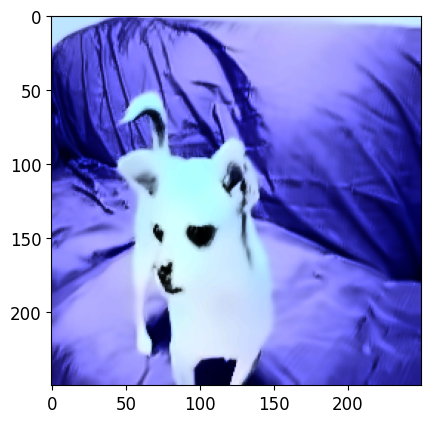

In [32]:
# Show exemple preprocessed image
plt.imshow(image.array_to_img(X[107]))

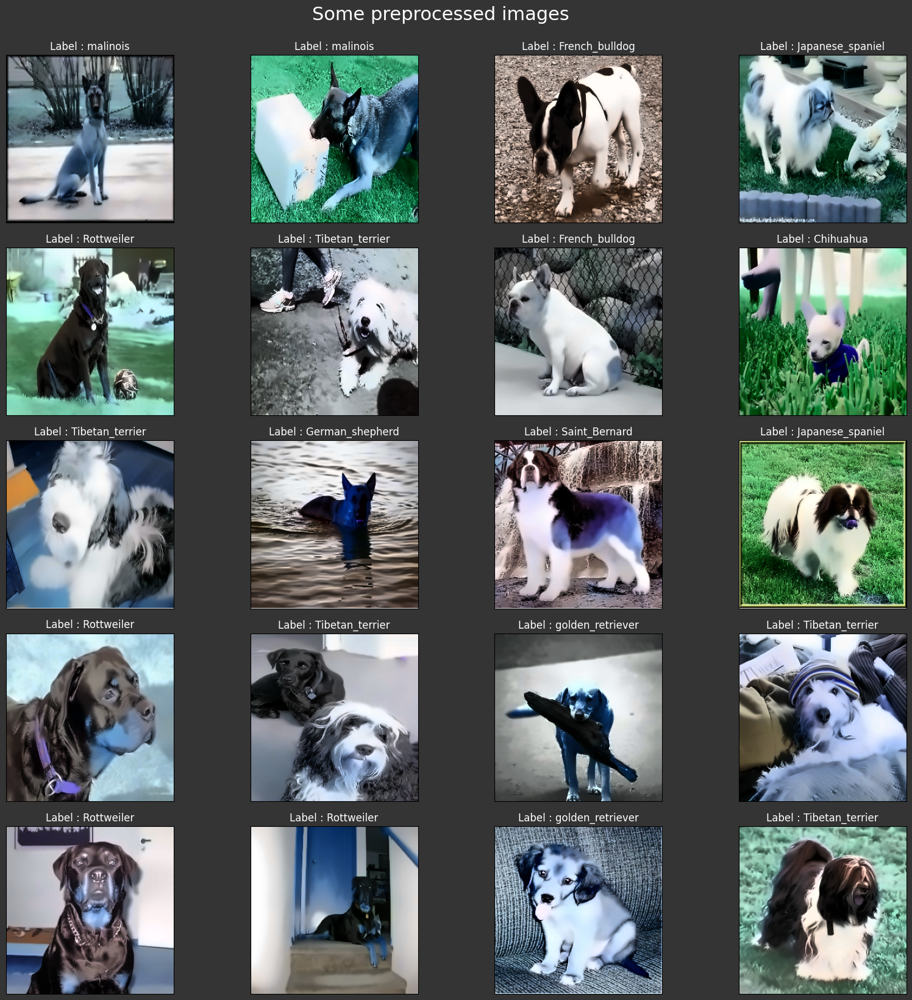

In [33]:
fig = plt.figure(1, figsize=(20,20))
fig.patch.set_facecolor('#343434')
plt.suptitle("Some preprocessed images",
             y=.92, fontsize=22,
             color="white")

n = 0

for i in range(20):
    n+=1
    r = int(np.random.randint(0, X.shape[0], 1))
    plt.subplot(5,4,n)
    plt.subplots_adjust(hspace = 0.15, wspace = 0.15)
    plt.imshow(keras.preprocessing.image.array_to_img(X[r]))
    plt.title('Label : {}'.format(y[r] ),
              color="white")
    plt.xticks([]) , plt.yticks([])
plt.savefig('image_preprocessed.png')  
plt.show()

### Data preprocessiong

In [34]:
# Using np.shuffle
img_space = np.arange(X.shape[0])
np.random.seed(42)
# Shuffle the space
np.random.shuffle(img_space)
# Apply to X and y in same order
X = X[img_space]
y = y[img_space]

In [35]:
from sklearn.preprocessing import LabelBinarizer, OneHotEncoder
#Convert X to float32 data type
X = X.astype(np.float32)

# Encode y using LabelEncoder
#label_encoder = LabelEncoder()
#y =label_encoder.fit_transform(y)
#lb = LabelBinarizer()
#y =lb.fit_transform(y)

In [36]:
### Create train and test set
X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)
label_encoder = LabelEncoder()
Y_train =label_encoder.fit_transform(Y_train)
#Y_val = label_encoder.transform(y_val)
Y_test = label_encoder.transform(Y_test)

# Split the train data into train and validation sets
x_train, x_val, y_train, y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)



# Print the shapes of the train, validation and test sets
print("-" * 50)
print("Size of created sets :")
print("-" * 50)
print("X_train shape:", X_train.shape[0])
print("x_train shape:", x_train.shape[0])
print("y_train shape:", y_train.shape[0])
print("X_val shape:", x_val.shape[0])
#print("y_val shape:", Y_val.shape[0])
print("X_test shape:", X_test.shape[0])
print("y_test shape:", Y_test.shape[0])

input_shape=X_train.shape[1:]
print("input shape:", input_shape)

--------------------------------------------------
Size of created sets :
--------------------------------------------------
X_train shape: 1300
x_train shape: 1040
y_train shape: 1040
X_val shape: 260
X_test shape: 326
y_test shape: 326
input shape: (250, 250, 3)


Let's check the the label elements.

In [37]:
# encoder classes
print(label_encoder.classes_)

['Chihuahua' 'Eskimo_dog' 'French_bulldog' 'German_shepherd'
 'Japanese_spaniel' 'Rottweiler' 'Saint_Bernard' 'Tibetan_terrier'
 'golden_retriever' 'malinois']


In [38]:
# Define data augmentation and rescaling for train set
train_datagen = ImageDataGenerator(rescale=1./255,
                                   rotation_range=40,
                                   width_shift_range=0.2,
                                   height_shift_range=0.2,
                                   shear_range=0.2,
                                   zoom_range=0.2,
                                   horizontal_flip=True,
                                   fill_mode='nearest',
                                   validation_split=0.2)

# Define rescaling for validation and test sets
val_test_datagen  = ImageDataGenerator(rescale=1./255)

In [39]:
from keras.utils import to_categorical

y_train_ = to_categorical(y_train, cat_number)
y_val_ = to_categorical(y_val, cat_number)
y_test_ = to_categorical(Y_test, cat_number)

In [40]:
batch_size = 8

# Generate batches of augmented data for training set
train_generator = train_datagen.flow(x_train,
                                     y_train,
                                     seed=42,
                                     batch_size=batch_size,
                                     subset='training')
# Generate batches of augmented data for validation set
val_generator = val_test_datagen.flow(x_val,
                                      y_val,
                                      seed=42,
                                      batch_size=batch_size,
                                      shuffle=False)

# Generate batches of augmented data for test set
test_generator = val_test_datagen.flow(X_test,
                                       Y_test,
                                       batch_size=batch_size,
                                       shuffle=False)

# Standard CNN

In [41]:
device_name = tf.test.gpu_device_name()
if "GPU" not in device_name:
    print("GPU device not found")
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


## Model Building

In [42]:
def build_cnn_model(input_shape, num_classes, 
                    conv_layers=3, dense_layers=2, 
                    filters=(16, 32, 32), kernel_size=(3, 3), 
                    pool_size=(2, 2), activation='relu', 
                    dropout=0.5, normalization='batch'):
    """
    Builds a convolutional neural network model using the Keras library.

    Parameters:
        input_shape (tuple): Shape of input data.
        num_classes (int): Number of output classes.
        conv_layers (int): Number of convolutional layers to add.
        dense_layers (int): Number of dense layers to add.
        filters (tuple): Number of filters to use in each convolutional layer.
        kernel_size (tuple): Size of the convolutional kernel.
        pool_size (tuple): Size of the max pooling layer.
        activation (str): Activation function to use for the layers.
        dropout (float): Dropout rate for the dense layers.
        normalization (str): Type of normalization to use, either 'batch' or 'layer'.

    Returns:
        model (tensorflow.python.keras.engine.sequential.Sequential): CNN model.
    """
    model = keras.models.Sequential()

    # Add convolutional layers
    for i in range(conv_layers):
        model.add(keras.layers.Conv2D(filters[i],
                                      kernel_size, 
                                      padding='same',
                                      use_bias=False, 
                                      activation=activation, 
                                      input_shape=input_shape))
        if normalization == 'batch':
            model.add(keras.layers.BatchNormalization())
        elif normalization == 'layer':
            model.add(keras.layers.LayerNormalization())

        model.add(keras.layers.MaxPooling2D(pool_size=pool_size, strides=(4, 4), padding='same'))
        print(f'Output shape after conv layer {i}: {model.output_shape}')

    # Add dense layers
    #print(f'Output shape after flatten layer: {model.output_shape}')
    for i in range(dense_layers):
        model.add(keras.layers.Dense(128, activation=activation))
 
    model.add(keras.layers.Dropout(dropout))
    print(f'Output shape after dense layer {i}: {model.output_shape}')
    
    # Add global average pooling layer
    model.add(keras.layers.GlobalAveragePooling2D())
    print(f'Output shape after global average pooling layer: {model.output_shape}')

    # Output layer
    model.add(keras.layers.Dense(num_classes, activation='softmax'))
    print(f'Output shape after output layer: {model.output_shape}')

    return model


In [43]:
import matplotlib.pyplot as plt
from tensorflow.keras.callbacks import History

def plot_history_scores(model_history: History) -> None:
    """Plots the training and validation accuracy and loss over epochs for a given model.

    Args:
        model_history (History): A Keras History object containing the training history of a model.

    Returns:
        None
    """

    # Plot training & validation accuracy values
    plt.plot(model_history.history['accuracy'])
    plt.plot(model_history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(model_history.history['loss'])
    plt.plot(model_history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

In [44]:
cnn=build_cnn_model(input_shape, cat_number, conv_layers=2, dense_layers=2, filters=(32,64, 128), kernel_size=(3, 3), pool_size=(4, 4), activation='relu', dropout=0.5, normalization='batch')

Output shape after conv layer 0: (None, 63, 63, 32)
Output shape after conv layer 1: (None, 16, 16, 64)
Output shape after dense layer 1: (None, 16, 16, 128)
Output shape after global average pooling layer: (None, 128)
Output shape after output layer: (None, 10)


In [45]:
cnn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 250, 250, 32)      864       
                                                                 
 batch_normalization (BatchN  (None, 250, 250, 32)     128       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 63, 63, 64)        18432     
                                                                 
 batch_normalization_1 (Batc  (None, 63, 63, 64)       256       
 hNormalization)                                                 
                                                        

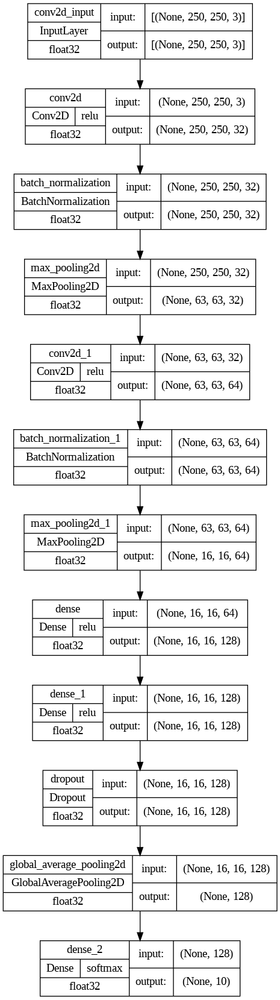

In [46]:
plot_model(cnn, to_file='CNN_model_plot.png', 
           show_shapes=True, show_layer_names=True, 
           show_dtype=True,  show_layer_activations=True, 
           show_trainable=False,)

In [47]:
from keras.optimizers import SGD
opt = SGD(learning_rate=0.01, momentum=0.9)

cnn=build_cnn_model(input_shape, cat_number, conv_layers=2, dense_layers=2, 
                    filters=(32,64, 128), kernel_size=(3, 3), pool_size=(4, 4), 
                    activation='relu', dropout=0.5, normalization='batch')
cnn.compile(loss='sparse_categorical_crossentropy', optimizer="adam", metrics=['accuracy'])

Output shape after conv layer 0: (None, 63, 63, 32)
Output shape after conv layer 1: (None, 16, 16, 64)
Output shape after dense layer 1: (None, 16, 16, 128)
Output shape after global average pooling layer: (None, 128)
Output shape after output layer: (None, 10)


In [48]:
history_raw = cnn.fit(
    x_train, y_train,
    validation_data=(x_val, y_val),
    batch_size=batch_size,
    epochs=40,
    verbose=1)

Epoch 1/40
130/130 [==============================] - 15s 29ms/step - loss: 2.3171 - accuracy: 0.1260 - val_loss: 2.5887 - val_accuracy: 0.1308
Epoch 2/40
130/130 [==============================] - 3s 23ms/step - loss: 2.2149 - accuracy: 0.1779 - val_loss: 2.2767 - val_accuracy: 0.1885
Epoch 3/40
130/130 [==============================] - 3s 24ms/step - loss: 2.1808 - accuracy: 0.1942 - val_loss: 2.1615 - val_accuracy: 0.2115
Epoch 4/40
130/130 [==============================] - 3s 23ms/step - loss: 2.1569 - accuracy: 0.2019 - val_loss: 2.3671 - val_accuracy: 0.1885
Epoch 5/40
130/130 [==============================] - 3s 23ms/step - loss: 2.1452 - accuracy: 0.2144 - val_loss: 2.2147 - val_accuracy: 0.1923
Epoch 6/40
130/130 [==============================] - 3s 23ms/step - loss: 2.0962 - accuracy: 0.2288 - val_loss: 2.1054 - val_accuracy: 0.2308
Epoch 7/40
130/130 [==============================] - 3s 23ms/step - loss: 2.0648 - accuracy: 0.2529 - val_loss: 2.1946 - val_accuracy: 0.192

In [49]:
# Evaluate the best model on the test data
train_loss, train_accuracy = cnn.evaluate(train_generator, batch_size=batch_size)
loss, accuracy = cnn.evaluate(test_generator)
print('Train accuracy:', train_accuracy, 'Test accuracy:', accuracy)

41/41 [==============================] - 1s 12ms/step - loss: 5.2185 - accuracy: 0.0951
Train accuracy: 0.08293269574642181 Test accuracy: 0.09509202092885971


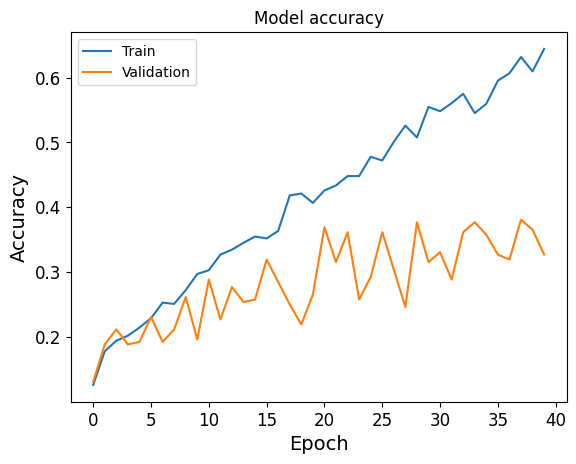

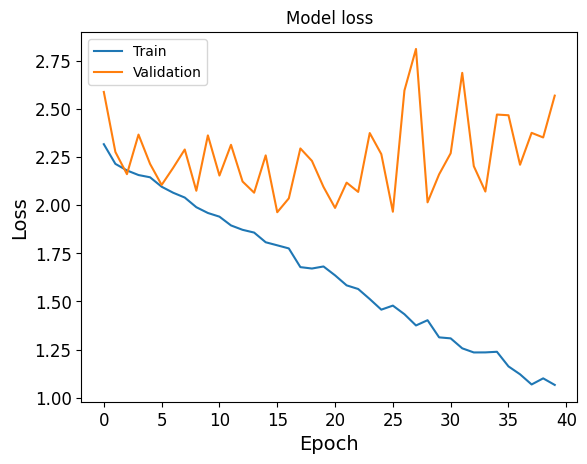

In [50]:
plot_history_scores(history_raw)

The model is underfit with non-augmented data

With the raw data without data augmentation, we can't improve the score because of the low quantity of data. In other words, the algorithm can't learn too much from our dataset. We need increase the tail of our data to allow algorithm to learn very well.

In [51]:
import math
history = cnn.fit(
    train_generator,
    validation_data=val_generator,
    batch_size=batch_size,
    epochs=40,
    verbose=1)

Epoch 1/40
104/104 [==============================] - 13s 112ms/step - loss: 1.9233 - accuracy: 0.3606 - val_loss: 2.7624 - val_accuracy: 0.0923
Epoch 2/40
104/104 [==============================] - 13s 120ms/step - loss: 1.7505 - accuracy: 0.3798 - val_loss: 6.9834 - val_accuracy: 0.1115
Epoch 3/40
104/104 [==============================] - 12s 117ms/step - loss: 1.7102 - accuracy: 0.4123 - val_loss: 5.2675 - val_accuracy: 0.1115
Epoch 4/40
104/104 [==============================] - 12s 117ms/step - loss: 1.6981 - accuracy: 0.4219 - val_loss: 4.4660 - val_accuracy: 0.1115
Epoch 5/40
104/104 [==============================] - 12s 117ms/step - loss: 1.6405 - accuracy: 0.4207 - val_loss: 4.5377 - val_accuracy: 0.1115
Epoch 6/40
104/104 [==============================] - 12s 111ms/step - loss: 1.6308 - accuracy: 0.4171 - val_loss: 3.6374 - val_accuracy: 0.1115
Epoch 7/40
104/104 [==============================] - 12s 119ms/step - loss: 1.6094 - accuracy: 0.4507 - val_loss: 3.1918 - val_ac

In [52]:
# Evaluate the best model on the test data
train_loss_and_metrics_batch = cnn.evaluate(train_generator, batch_size=batch_size)
loss_and_metrics_batch = cnn.evaluate(test_generator, batch_size=batch_size)
print('Train accuracy:', train_loss_and_metrics_batch[1], 'Test accuracy:', loss_and_metrics_batch[1])

41/41 [==============================] - 0s 10ms/step - loss: 2.0507 - accuracy: 0.4172
Train accuracy: 0.5817307829856873 Test accuracy: 0.4171779155731201


With data augmentation, the model is already underfit, but it seems to have a better accuracy

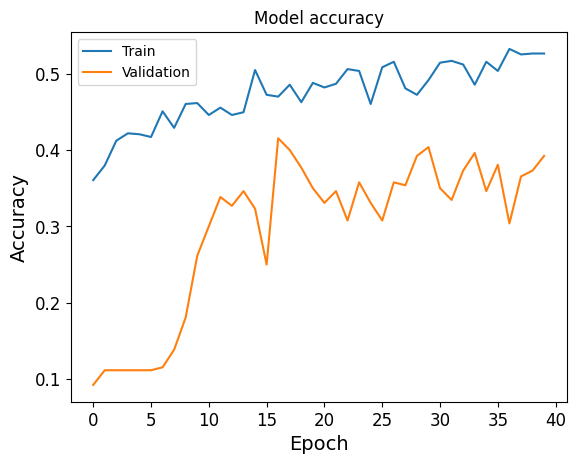

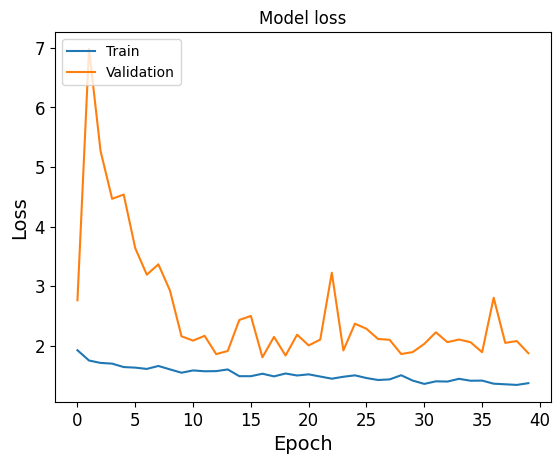

In [53]:
plot_history_scores(history)

In [54]:
cnn_layer=build_cnn_model(input_shape, cat_number, conv_layers=3, dense_layers=2, 
                          filters=(32,64, 128), kernel_size=(3, 3), pool_size=(4, 4), 
                          activation='relu', dropout=0.5, normalization='layer')

cnn_layer.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])


Output shape after conv layer 0: (None, 63, 63, 32)
Output shape after conv layer 1: (None, 16, 16, 64)
Output shape after conv layer 2: (None, 4, 4, 128)
Output shape after dense layer 1: (None, 4, 4, 128)
Output shape after global average pooling layer: (None, 128)
Output shape after output layer: (None, 10)


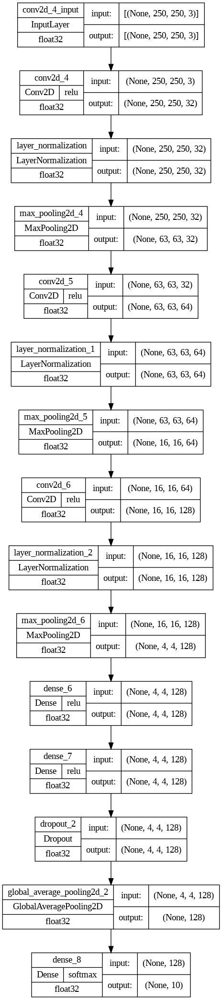

In [55]:
plot_model(cnn_layer, to_file='CNN_layer_model_plot.png', 
           show_shapes=True, show_layer_names=True, 
           show_dtype=True,  show_layer_activations=True, 
           show_trainable=False,)

In [56]:

history_layer = cnn_layer.fit(
    train_generator,
    validation_data=val_generator,
    batch_size = batch_size,
    epochs=45,
    verbose=1)


Epoch 1/45
104/104 [==============================] - 17s 139ms/step - loss: 2.3596 - accuracy: 0.1058 - val_loss: 2.3084 - val_accuracy: 0.1192
Epoch 2/45
104/104 [==============================] - 14s 137ms/step - loss: 2.3079 - accuracy: 0.1154 - val_loss: 2.3037 - val_accuracy: 0.0923
Epoch 3/45
104/104 [==============================] - 14s 136ms/step - loss: 2.3054 - accuracy: 0.1130 - val_loss: 2.3016 - val_accuracy: 0.1192
Epoch 4/45
104/104 [==============================] - 14s 136ms/step - loss: 2.2910 - accuracy: 0.1370 - val_loss: 2.2950 - val_accuracy: 0.1269
Epoch 5/45
104/104 [==============================] - 14s 136ms/step - loss: 2.2770 - accuracy: 0.1490 - val_loss: 2.2763 - val_accuracy: 0.1423
Epoch 6/45
104/104 [==============================] - 14s 136ms/step - loss: 2.2754 - accuracy: 0.1526 - val_loss: 2.3047 - val_accuracy: 0.1192
Epoch 7/45
104/104 [==============================] - 14s 137ms/step - loss: 2.2622 - accuracy: 0.1659 - val_loss: 2.2696 - val_ac

In [57]:
# Evaluate the best model on the test data
train_loss_and_metrics_layer = cnn_layer.evaluate(train_generator, batch_size=batch_size)
loss_and_metrics_layer = cnn_layer.evaluate(test_generator, batch_size=batch_size)
print('Train accuracy:', train_loss_and_metrics_layer[1], 'Test accuracy:', loss_and_metrics_layer[1])

41/41 [==============================] - 1s 32ms/step - loss: 2.0200 - accuracy: 0.3006
Train accuracy: 0.3774038553237915 Test accuracy: 0.30061349272727966


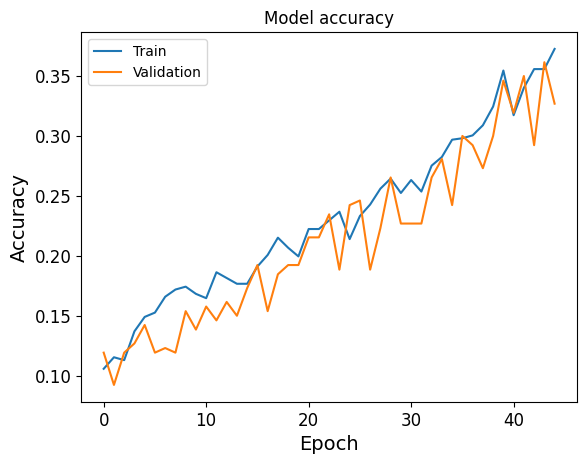

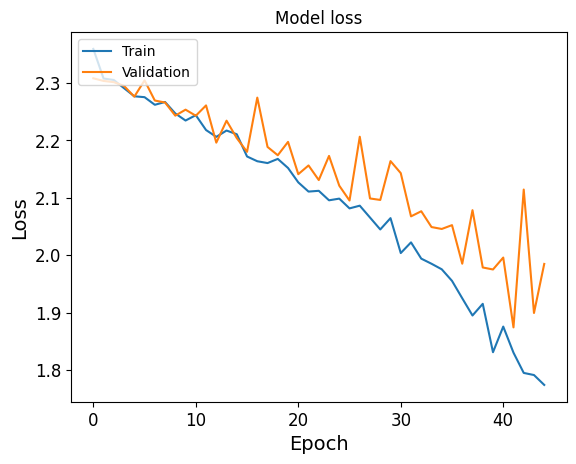

In [58]:
plot_history_scores(history_layer)

With the layer normalizatio, is ot overfit, but the accuracy is too low. We'll try to address to this problem by fine tunning the model hyperparameters.

To do so, we use Kerastuner optimizers. We test its <code>RandomSearch <code> and <code>Hyperband<code> parameters

## Model fine tune

In [59]:


# Define hyperparameters search space
hp = HyperParameters()
hp.Int('conv_layers', 2, 7, default=3)
hp.Int('dense_layers', 1, 3, default=1)
hp.Choice('normalization', values=['batch', 'layer'], default='batch')
for i in range(10):
    hp.Int(f'filters_{i}', 16, 128, step=16, default=32)
    hp.Choice(f'kernel_size_{i}', values=[3, 4, 5], default=3)
    hp.Choice(f'activation_{i}', values=['relu', 'tanh', 'sigmoid'], default='relu')
for i in range(3):
    hp.Int(f'units_{i}', 16, 512, step=16, default=32)
    hp.Choice(f'activation_dense_{i}', values=['relu', 'tanh', 'sigmoid'], default='relu')
    hp.Float(f'dropout_{i}', 0.0, 0.5, step=0.1, default=0.25)
hp.Choice('learning_rate', values=[0.001, 0.01], default=0.001)

# Define model builder function
def build_model(hp):
    model = keras.models.Sequential()

    # Add convolutional layers
    for i in range(hp.get('conv_layers')):
        model.add(layers.Conv2D(hp.get(f'filters_{i}'),
                                hp.get(f'kernel_size_{i}'),
                                padding='same',
                                activation=hp.get(f'activation_{i}'),
                                input_shape=input_shape))
        if hp.get('normalization') == 'batch':
            model.add(layers.BatchNormalization())
        else:
            model.add(layers.LayerNormalization())

        model.add(layers.MaxPooling2D())

    # Add dense layers
    model.add(layers.Flatten())
    for i in range(hp.get('dense_layers')):
        model.add(layers.Dense(units=hp.get(f'units_{i}'),
                               activation=hp.get(f'activation_dense_{i}')))
        model.add(layers.Dropout(hp.get(f'dropout_{i}')))

    # Output layer
    model.add(layers.Dense(cat_number, activation='softmax'))

    # Compile model
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=hp.get('learning_rate')),
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    return model



In [60]:
# Define tuner and start search
random_tuner = RandomSearch(build_model, objective='val_accuracy', max_trials=10, hyperparameters=hp)
random_tuner.search(train_generator, epochs=10, validation_data=val_generator)

Trial 10 Complete [00h 02m 34s]
val_accuracy: 0.1269230842590332

Best val_accuracy So Far: 0.26538461446762085
Total elapsed time: 00h 27m 55s


In [61]:
# Get best model and print summary
random_best_model = random_tuner.get_best_models(num_models=1)[0]
random_best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 250, 250, 96)      2688      
                                                                 
 batch_normalization (BatchN  (None, 250, 250, 96)     384       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 125, 125, 96)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 128)     110720    
                                                                 
 batch_normalization_1 (Batc  (None, 125, 125, 128)    512       
 hNormalization)                                                 
                                                        

In [62]:
random_history = random_best_model.fit(train_generator,
               epochs=40,
               batch_size=batch_size,
               validation_data=val_generator,
               validation_batch_size=batch_size)

Epoch 1/40
104/104 [==============================] - 20s 136ms/step - loss: 2.1467 - accuracy: 0.2151 - val_loss: 2.1816 - val_accuracy: 0.1769
Epoch 2/40
104/104 [==============================] - 14s 135ms/step - loss: 2.1540 - accuracy: 0.2007 - val_loss: 2.0530 - val_accuracy: 0.2154
Epoch 3/40
104/104 [==============================] - 14s 135ms/step - loss: 2.1668 - accuracy: 0.1815 - val_loss: 2.1010 - val_accuracy: 0.2231
Epoch 4/40
104/104 [==============================] - 14s 136ms/step - loss: 2.1435 - accuracy: 0.2296 - val_loss: 2.1174 - val_accuracy: 0.2077
Epoch 5/40
104/104 [==============================] - 14s 135ms/step - loss: 2.1309 - accuracy: 0.2019 - val_loss: 2.1639 - val_accuracy: 0.2154
Epoch 6/40
104/104 [==============================] - 14s 135ms/step - loss: 2.1243 - accuracy: 0.2175 - val_loss: 2.0527 - val_accuracy: 0.2577
Epoch 7/40
104/104 [==============================] - 15s 139ms/step - loss: 2.1392 - accuracy: 0.2175 - val_loss: 2.0356 - val_ac

We fix random state

In [63]:
import tensorflow.keras as keras
from kerastuner import RandomSearch
from kerastuner.engine.hyperparameters import HyperParameters

# Set random seed for reproducibility
np.random.seed(42)

def fine_tune_model(hp):
    model = keras.models.Sequential()

    # Add convolutional layers
    for i in range(hp.Int('conv_layers', 2, 7)):
        model.add(layers.Conv2D(hp.Choice(f'filters_{i}', values=[16, 32, 64, 128]),
                                hp.Choice(f'kernel_size_{i}', values=[3, 4, 5]),
                                padding='same',
                                activation=hp.Choice(f'activation_{i}', values=['relu', 'tanh', 'sigmoid']),
                                input_shape=input_shape))
        if hp.Choice('normalization', values=['batch', 'layer']) == 'batch':
            model.add(layers.BatchNormalization())
        else:
            model.add(layers.LayerNormalization())

        model.add(layers.MaxPooling2D())

    # Add dense layers
    #model.add(layers.Flatten())
    model.add(keras.layers.GlobalAveragePooling2D())
    for i in range(hp.Int('dense_layers', 1, 3)):
        model.add(layers.Dense(units=hp.Int(f'units_{i}', min_value=16, max_value=512, step=16),
                               activation=hp.Choice(f'activation_dense_{i}', values=['relu', 'tanh', 'sigmoid'])))
        model.add(layers.Dropout(hp.Float(f'dropout_{i}', min_value=0.0, max_value=0.5, step=0.1)))

    # Output layer
    model.add(layers.Dense(cat_number, activation='softmax'))

    # Compile model
    model.compile(optimizer=keras.optimizers.SGD(learning_rate=hp.Choice('learning_rate', values=[0.001, 0.01])),
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    return model



In [64]:
random_seed_tuner = RandomSearch(fine_tune_model,
                                 objective='val_accuracy',
                                 max_trials=10,
                                 seed=42,  # set random seed
                                 executions_per_trial= 1,
                                 directory='fine_tune',
                                 project_name='random_tuning')

random_seed_tuner.search(train_generator,
             epochs=10,
             validation_data=val_generator)

Trial 10 Complete [00h 03m 08s]
val_accuracy: 0.13076923787593842

Best val_accuracy So Far: 0.18076923489570618
Total elapsed time: 00h 26m 36s


In [65]:
# Get best model and print summary
random_seed_best_model = random_seed_tuner.get_best_models(num_models=1)[0]
random_seed_best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 250, 250, 64)      1792      
                                                                 
 batch_normalization (BatchN  (None, 250, 250, 64)     256       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 125, 125, 64)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 128)     204928    
                                                                 
 batch_normalization_1 (Batc  (None, 125, 125, 128)    512       
 hNormalization)                                                 
                                                        

In [66]:
random_best_model.fit(train_generator,
               epochs=20,
               batch_size = batch_size,
               validation_data=val_generator)

Epoch 1/20
104/104 [==============================] - 15s 135ms/step - loss: 2.0057 - accuracy: 0.2524 - val_loss: 3.0958 - val_accuracy: 0.1269
Epoch 2/20
104/104 [==============================] - 14s 135ms/step - loss: 2.0292 - accuracy: 0.2440 - val_loss: 2.3717 - val_accuracy: 0.1500
Epoch 3/20
104/104 [==============================] - 14s 134ms/step - loss: 2.0541 - accuracy: 0.2620 - val_loss: 2.1591 - val_accuracy: 0.2038
Epoch 4/20
104/104 [==============================] - 14s 135ms/step - loss: 2.0486 - accuracy: 0.2596 - val_loss: 2.0117 - val_accuracy: 0.2346
Epoch 5/20
104/104 [==============================] - 14s 134ms/step - loss: 2.0227 - accuracy: 0.2740 - val_loss: 2.0010 - val_accuracy: 0.2731
Epoch 6/20
104/104 [==============================] - 14s 135ms/step - loss: 2.0490 - accuracy: 0.2440 - val_loss: 2.0065 - val_accuracy: 0.2308
Epoch 7/20
104/104 [==============================] - 14s 134ms/step - loss: 2.0403 - accuracy: 0.2332 - val_loss: 2.0382 - val_ac

In [67]:
# Evaluate the best model on the test data
train_loss_and_metrics_random = random_best_model.evaluate(train_generator, batch_size=batch_size)
loss_and_metrics_random= random_best_model.evaluate(test_generator, batch_size=batch_size)
print('Train accuracy:', train_loss_and_metrics_random[1], 'Test accuracy:', loss_and_metrics_random[1])

41/41 [==============================] - 2s 37ms/step - loss: 1.9708 - accuracy: 0.2822
Train accuracy: 0.23798076808452606 Test accuracy: 0.2822085916996002


In [68]:
input_shape = input_shape
num_classes = cat_number

tuner = kt.Hyperband(fine_tune_model,
                     objective='val_accuracy',
                     max_epochs=10,
                     factor=3,
                     directory='fine_tune',
                     project_name='hyperband_fine_tune')

tuner.search(train_generator, epochs=10, validation_data=val_generator)

Trial 30 Complete [00h 03m 12s]
val_accuracy: 0.1230769231915474

Best val_accuracy So Far: 0.19615384936332703
Total elapsed time: 00h 33m 21s


In [69]:

# Print the best hyperparameters found
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
print("Best Hyperparameters:")
print(best_hps.values)

Best Hyperparameters:
{'conv_layers': 5, 'filters_0': 32, 'kernel_size_0': 5, 'activation_0': 'relu', 'normalization': 'batch', 'filters_1': 128, 'kernel_size_1': 5, 'activation_1': 'tanh', 'dense_layers': 1, 'units_0': 112, 'activation_dense_0': 'sigmoid', 'dropout_0': 0.0, 'learning_rate': 0.01, 'filters_2': 128, 'kernel_size_2': 5, 'activation_2': 'relu', 'filters_3': 128, 'kernel_size_3': 4, 'activation_3': 'relu', 'filters_4': 32, 'kernel_size_4': 5, 'activation_4': 'sigmoid', 'units_1': 112, 'activation_dense_1': 'relu', 'dropout_1': 0.30000000000000004, 'units_2': 432, 'activation_dense_2': 'relu', 'dropout_2': 0.1, 'filters_5': 16, 'kernel_size_5': 3, 'activation_5': 'tanh', 'tuner/epochs': 10, 'tuner/initial_epoch': 4, 'tuner/bracket': 1, 'tuner/round': 1, 'tuner/trial_id': '0020'}


In [70]:
# Get the best model
hyper_best_model = tuner.get_best_models(num_models=1)[0]
hyper_best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 250, 250, 32)      2432      
                                                                 
 batch_normalization (BatchN  (None, 250, 250, 32)     128       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 125, 125, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 128)     102528    
                                                                 
 batch_normalization_1 (Batc  (None, 125, 125, 128)    512       
 hNormalization)                                                 
                                                        

In [71]:
history_cnn = hyper_best_model.fit(train_generator,
                                   validation_data=val_generator,
                                   batch_size=batch_size,
                                   epochs=40,
                                   verbose=1)

Epoch 1/40
104/104 [==============================] - 15s 131ms/step - loss: 2.1548 - accuracy: 0.2127 - val_loss: 2.1795 - val_accuracy: 0.1808
Epoch 2/40
104/104 [==============================] - 14s 131ms/step - loss: 2.1357 - accuracy: 0.2320 - val_loss: 2.3556 - val_accuracy: 0.1577
Epoch 3/40
104/104 [==============================] - 14s 131ms/step - loss: 2.1105 - accuracy: 0.2344 - val_loss: 2.1857 - val_accuracy: 0.2423
Epoch 4/40
104/104 [==============================] - 14s 130ms/step - loss: 2.1168 - accuracy: 0.2188 - val_loss: 2.1214 - val_accuracy: 0.2192
Epoch 5/40
104/104 [==============================] - 13s 128ms/step - loss: 2.0866 - accuracy: 0.2512 - val_loss: 2.2786 - val_accuracy: 0.1885
Epoch 6/40
104/104 [==============================] - 13s 128ms/step - loss: 2.1127 - accuracy: 0.2320 - val_loss: 2.3690 - val_accuracy: 0.1462
Epoch 7/40
104/104 [==============================] - 14s 131ms/step - loss: 2.0850 - accuracy: 0.2332 - val_loss: 2.2756 - val_ac

In [72]:
# Evaluate the best model on the test data
train_loss_and_metrics_hyper = hyper_best_model.evaluate(train_generator, batch_size=batch_size)
loss_and_metrics_hyper = hyper_best_model.evaluate(test_generator, batch_size=batch_size)
print('Train accuracy:', train_loss_and_metrics_hyper[1], 'Test accuracy:', loss_and_metrics_hyper[1])

41/41 [==============================] - 1s 32ms/step - loss: 1.7701 - accuracy: 0.3742
Train accuracy: 0.3978365361690521 Test accuracy: 0.3742331266403198


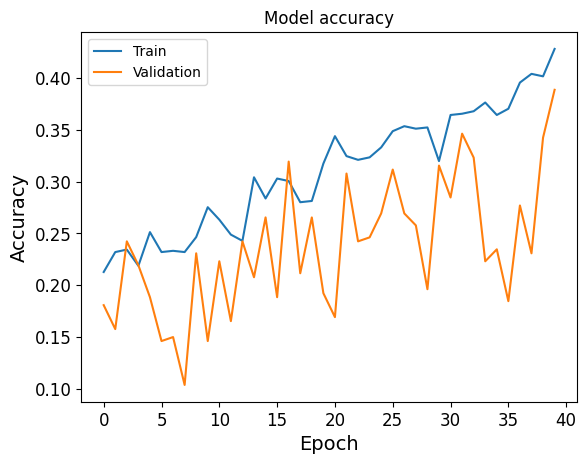

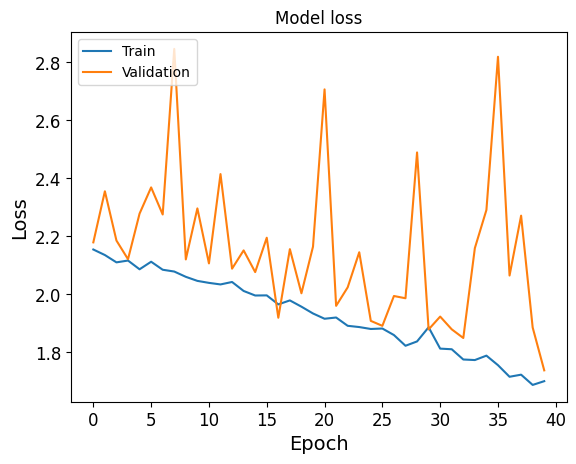

In [73]:
plot_history_scores(history_cnn)

The best model is find with the hyperband tunner.

The CNN Model is underfit despite the fine tuning. 

We need to increase the search interval and our dataset also to deal with this underfitting.

# Transfert Learning 

## Xception

In [74]:
# Import Xception trained model
xception = tf.keras.applications.xception.Xception(
    weights='imagenet',
    include_top=False, 
    pooling='avg',
    input_shape=input_shape)

# look at the differents layers
print("-" * 50)
print("Xception base model layers :")
print("-" * 50)
for layer in xception.layers:
    print(layer)



83683744/83683744 [==============================] - 5s 0us/step
--------------------------------------------------
Xception base model layers :
--------------------------------------------------


In [75]:
for layer in xception.layers:
    layer.trainable = False

In [76]:
# Add new fully-connected layers
base_output = xception.output
base_output = Dense(128, activation='relu')(base_output)
base_output = Dropout(0.2)(base_output)
# Output : new classifier
predictions = Dense(cat_number, activation='softmax')(base_output)

# Define new model
xcept_model = Model(inputs=xception.input,
                       outputs=predictions)
xcept_model.compile(optimizer="adam",
                       loss="sparse_categorical_crossentropy",
                       metrics=["accuracy"])

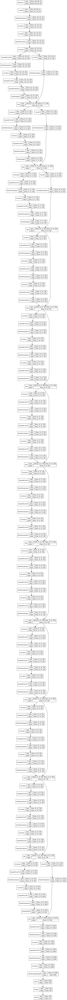

In [77]:
Xception_plot = plot_model(xcept_model,
                           to_file='xcept_model_plot.png',
                           show_shapes=True,
                           show_layer_names=False)
Xception_plot

In [78]:
# and preprocess_input Xception
# Validation set is define here
xception_train_datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2,
    preprocessing_function=tf.keras.applications.xception.preprocess_input)



#For validation and test, just rescale
xception_val_datagen = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.xception.preprocess_input)

xception_test_datagen = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.xception.preprocess_input)

xception_train = xception_train_datagen.flow(x_train, y_train,
                                             batch_size=batch_size,
                                             seed=42,
                                             subset='training')
xception_val = xception_val_datagen.flow(x_val, y_val,
                                         seed=42,
                                         batch_size=batch_size)
xception_test = xception_test_datagen.flow(X_test, Y_test,
                                         seed=42,
                                         batch_size=batch_size)

In [81]:
history_xcept = xcept_model.fit(
    xception_train,
    batch_size=batch_size,
    validation_data=xception_val,
    epochs=20,
    verbose=1)

Epoch 1/20
104/104 [==============================] - 15s 147ms/step - loss: 0.3258 - accuracy: 0.8882 - val_loss: 0.3360 - val_accuracy: 0.9115
Epoch 2/20
104/104 [==============================] - 14s 133ms/step - loss: 0.2900 - accuracy: 0.9062 - val_loss: 0.4124 - val_accuracy: 0.8808
Epoch 3/20
104/104 [==============================] - 14s 135ms/step - loss: 0.2581 - accuracy: 0.9123 - val_loss: 0.3849 - val_accuracy: 0.8769
Epoch 4/20
104/104 [==============================] - 14s 133ms/step - loss: 0.3320 - accuracy: 0.8858 - val_loss: 0.3854 - val_accuracy: 0.9000
Epoch 5/20
104/104 [==============================] - 15s 143ms/step - loss: 0.2639 - accuracy: 0.9171 - val_loss: 0.4064 - val_accuracy: 0.8846
Epoch 6/20
104/104 [==============================] - 14s 130ms/step - loss: 0.2430 - accuracy: 0.9171 - val_loss: 0.5273 - val_accuracy: 0.8769
Epoch 7/20
104/104 [==============================] - 14s 132ms/step - loss: 0.2751 - accuracy: 0.9062 - val_loss: 0.4042 - val_ac

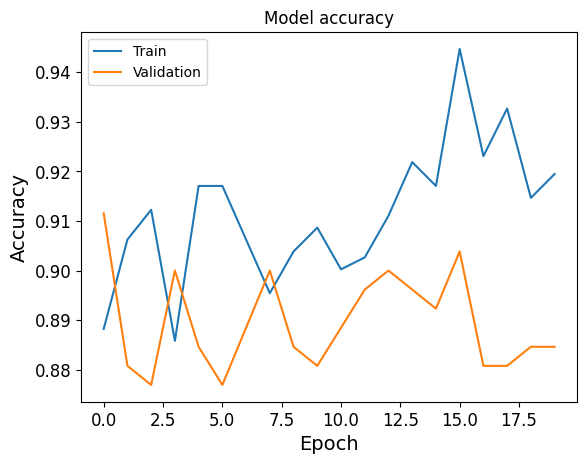

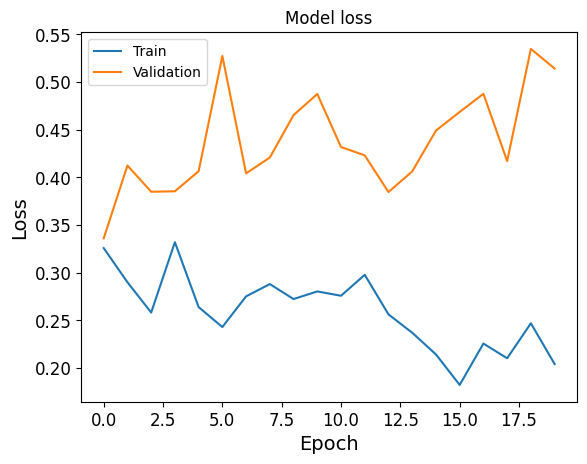

In [82]:
plot_history_scores(history_xcept)

In [83]:
from typing import Dict, List

def compare_histories(histories: Dict[str, History], metrics: List[str], title: str, figsize: tuple=(13,10)) -> None:
    """Plots the given metrics for multiple models over epochs.

    Args:
        histories (Dict[str, History]): A dictionary mapping model names to their History objects.
        metrics (List[str]): A list of metric names to plot.
        title (str): The title of the plot.
        figsize (tuple, optional): The size of the plot. Defaults to (13,10).

    Returns:
        None
    """

    with plt.style.context('seaborn-whitegrid'):
        plt.figure(figsize=figsize)

        for name, history in histories.items():
            for metric in metrics:
                plt.plot(history.history[metric],
                         label=name + ' - Mean {}: {:.2f}'.format(
                             metric, np.mean(history.history[metric])))

        plt.title(title, fontsize=18)
        plt.ylabel('Value')
        plt.xlabel('Epoch')
        plt.legend(loc='upper right')
        plt.show()


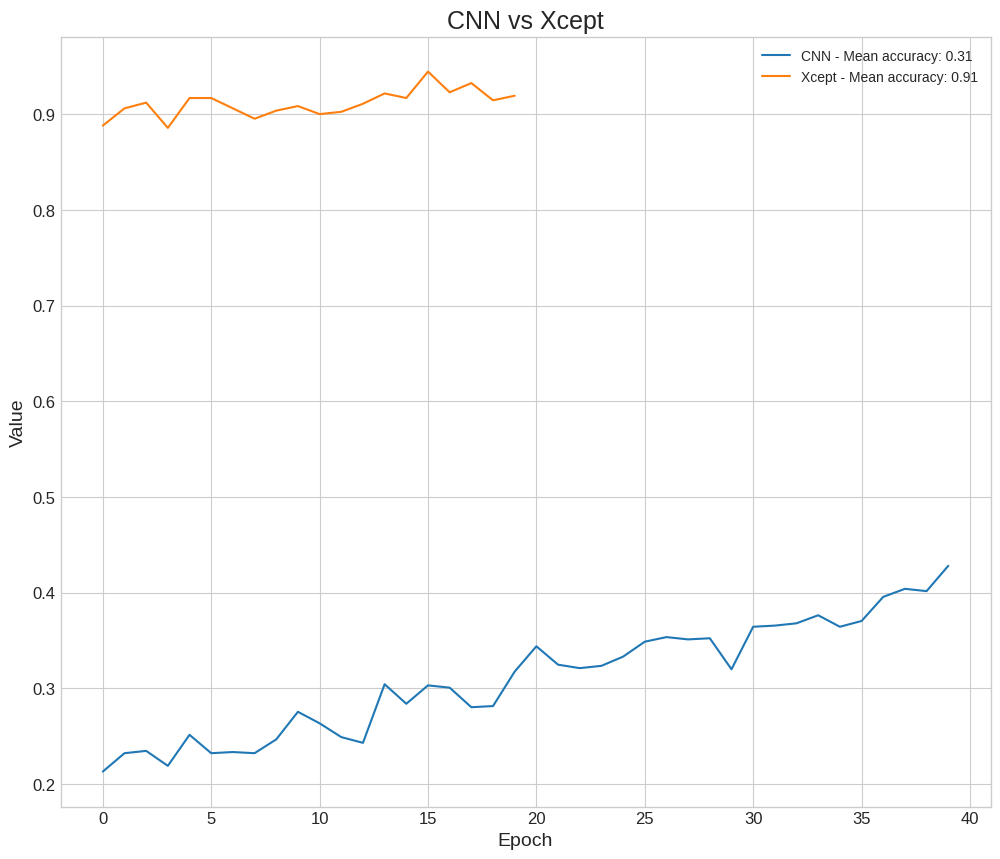

In [84]:
histories = {"CNN":history_cnn, "Xcept":history_xcept}
metrics = ["accuracy"]
title = "CNN vs Xcept"
figsize = (12, 10)
compare_histories(histories= histories, metrics=metrics, title=title, figsize=figsize )

In [85]:
# We fit the model on the train_generator
history_xcept_ = xcept_model.fit(
    train_generator,
    validation_data=val_generator,
    batch_size=batch_size,
    validation_batch_size=batch_size,
    epochs=20,
    verbose=1)

Epoch 1/20
104/104 [==============================] - 14s 134ms/step - loss: 0.2459 - accuracy: 0.9111 - val_loss: 0.5066 - val_accuracy: 0.8846
Epoch 2/20
104/104 [==============================] - 14s 133ms/step - loss: 0.2400 - accuracy: 0.9147 - val_loss: 0.5614 - val_accuracy: 0.8808
Epoch 3/20
104/104 [==============================] - 14s 132ms/step - loss: 0.2579 - accuracy: 0.9195 - val_loss: 0.5377 - val_accuracy: 0.8692
Epoch 4/20
104/104 [==============================] - 14s 132ms/step - loss: 0.2208 - accuracy: 0.9183 - val_loss: 0.5179 - val_accuracy: 0.8731
Epoch 5/20
104/104 [==============================] - 14s 133ms/step - loss: 0.2711 - accuracy: 0.8990 - val_loss: 0.4557 - val_accuracy: 0.8615
Epoch 6/20
104/104 [==============================] - 14s 133ms/step - loss: 0.2067 - accuracy: 0.9363 - val_loss: 0.5515 - val_accuracy: 0.8577
Epoch 7/20
104/104 [==============================] - 15s 144ms/step - loss: 0.2777 - accuracy: 0.8978 - val_loss: 0.5009 - val_ac

In [86]:
# Evaluate the best model on the test data
train_loss_and_metrics_xcept = xcept_model.evaluate(train_generator, batch_size=batch_size)
loss_and_metrics_xcept = xcept_model.evaluate(test_generator, batch_size=batch_size)
print('Train accuracy:', train_loss_and_metrics_xcept[1], 'Test accuracy:', loss_and_metrics_xcept[1])

41/41 [==============================] - 2s 56ms/step - loss: 0.4235 - accuracy: 0.8988
Train accuracy: 0.953125 Test accuracy: 0.8987730145454407


## ResNet50

In [ ]:
# Import ResNet50 trained model
resnet = tf.keras.applications.ResNet50(
    weights='imagenet',
    include_top=False, 
    pooling='avg',
    input_shape=(299,299,3))

# Dont retrain layers
for rn_layer in resnet.layers:
    rn_layer.trainable = False
    
# Add new fully-connected layers
rn_base_output = resnet.output
rn_base_output = Dense(128, activation='relu')(rn_base_output)
rn_base_output = Dropout(0.2)(rn_base_output)
# Output : new classifier
rn_predictions = Dense(cat_number, activation='softmax')(rn_base_output)

# Define new model
resnet_model = Model(inputs=resnet.input,
                        outputs=rn_predictions)
resnet_model.compile(optimizer="adam",
                     loss="sparse_categorical_crossentropy",
                     metrics=["accuracy"])

# Data generator on train set with Data Augmentation
# and preprocess_input Resnet
# Validation set is define here
rn_train_datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2,
    preprocessing_function=tf.keras.applications.resnet.preprocess_input)

#For validation and test, just rescale
rn_test_datagen = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.resnet.preprocess_input)

rn_train =rn_train_datagen.flow( x_train,
                                y_train,
                                seed=42,
                                batch_size=batch_size,
                                subset='training')
rn_val =rn_test_datagen.flow( x_val,
                                y_val,
                                seed=42,
                                batch_size=batch_size)

rn_val =rn_test_datagen.flow( x_val,
                                y_val,
                                seed=42,
                                batch_size=batch_size,)

  901120/94765736 [..............................] - ETA: 1:25

In [89]:
history_resnet = resnet_model.fit(rn_train,
                                  validation_data=rn_val,
                                  batch_size=batch_size,
                                  validation_batch_size=batch_size,
                                  epochs=20,
                                  verbose=1)

Epoch 1/20
104/104 [==============================] - 14s 134ms/step - loss: 0.3950 - accuracy: 0.8618 - val_loss: 0.5411 - val_accuracy: 0.8154
Epoch 2/20
104/104 [==============================] - 13s 129ms/step - loss: 0.3702 - accuracy: 0.8654 - val_loss: 0.5941 - val_accuracy: 0.8192
Epoch 3/20
104/104 [==============================] - 15s 141ms/step - loss: 0.3874 - accuracy: 0.8714 - val_loss: 0.4830 - val_accuracy: 0.8577
Epoch 4/20
104/104 [==============================] - 14s 134ms/step - loss: 0.3486 - accuracy: 0.8618 - val_loss: 0.6047 - val_accuracy: 0.8077
Epoch 5/20
104/104 [==============================] - 14s 131ms/step - loss: 0.3075 - accuracy: 0.8954 - val_loss: 0.5263 - val_accuracy: 0.8654
Epoch 6/20
104/104 [==============================] - 14s 132ms/step - loss: 0.3018 - accuracy: 0.8990 - val_loss: 0.5033 - val_accuracy: 0.8423
Epoch 7/20
104/104 [==============================] - 14s 132ms/step - loss: 0.3263 - accuracy: 0.8786 - val_loss: 0.6714 - val_ac

In [90]:
# Evaluate the best model on the test data
train_loss_and_metrics_resnet = resnet_model.evaluate(train_generator, batch_size=batch_size)
loss_and_metrics_resnet = resnet_model.evaluate(test_generator, batch_size=batch_size)
print('Train accuracy:', train_loss_and_metrics_resnet[1], 'Test accuracy:', loss_and_metrics_resnet[1])

41/41 [==============================] - 2s 56ms/step - loss: 4.8524 - accuracy: 0.1380
Train accuracy: 0.11057692021131516 Test accuracy: 0.1380368024110794


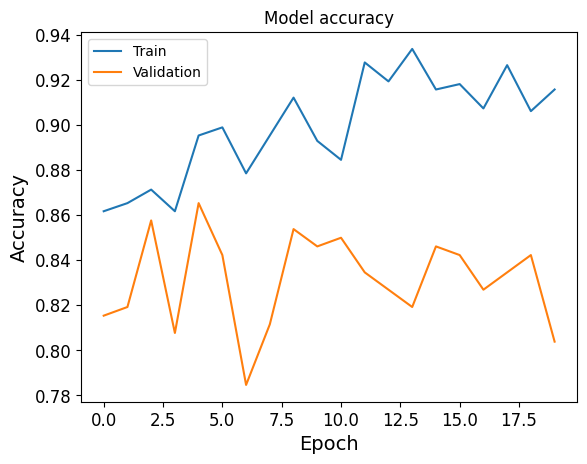

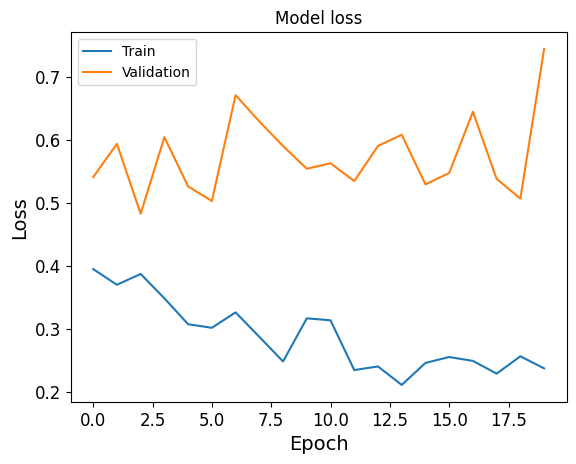

In [91]:
plot_history_scores(history_resnet)

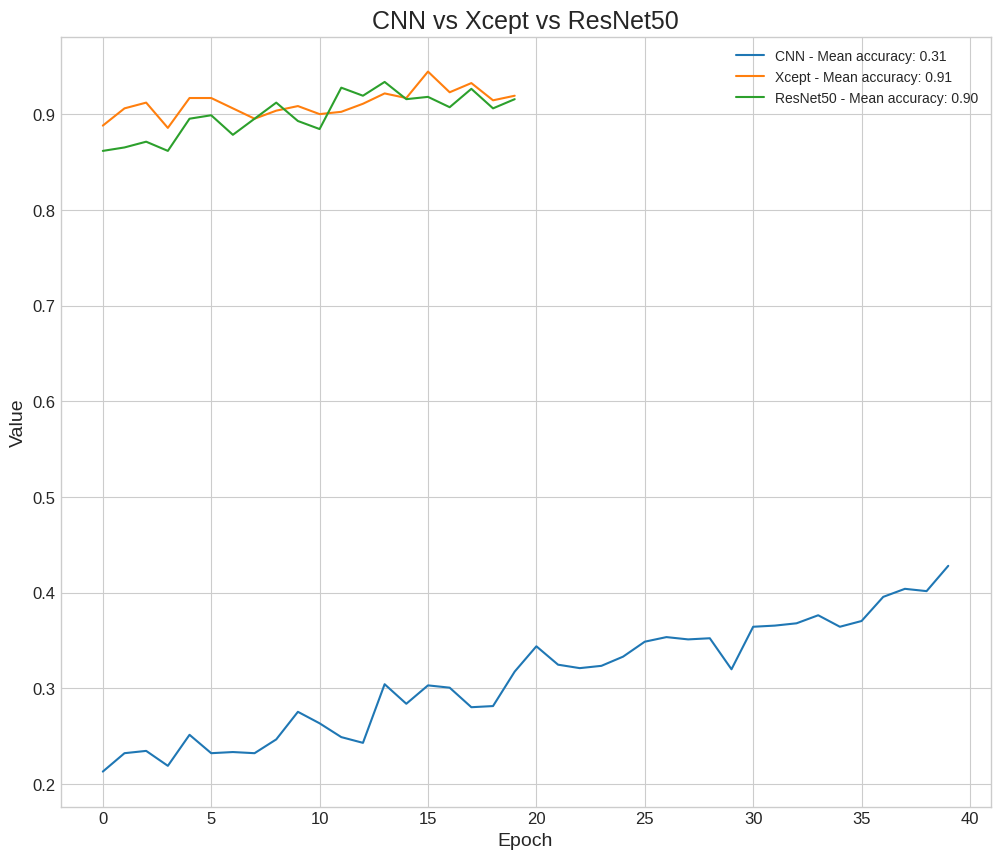

In [92]:
histories["ResNet50"] = history_resnet
title = "CNN vs Xcept vs ResNet50"
compare_histories(histories= histories, metrics=metrics, title=title, figsize=figsize )

## VGG

In [93]:
from keras.applications import VGG16

# Load the pre-trained VGG16 model, excluding the fully connected layers
base_model = VGG16(include_top=False, input_shape=input_shape)

# Freeze the pre-trained layers
for layer in base_model.layers:
    layer.trainable = False

# Create a new model on top
vgg = Sequential()
vgg.add(base_model)

# Add a new fully connected layer for the output

vgg.add(GlobalAveragePooling2D())
vgg.add(Dense(128, activation='relu'))
vgg.add(Dropout(0.2))
vgg.add(Dense(cat_number, activation='softmax'))

# Compile the model with a suitable optimizer, loss function, and metrics
vgg.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])


58889256/58889256 [==============================] - 5s 0us/step


In [94]:
# Define data augmentation for the training data
vgg_train_datagen = ImageDataGenerator(rotation_range=40,
                                       width_shift_range=0.2,
                                       height_shift_range=0.2,
                                       shear_range=0.2,
                                       zoom_range=0.2,
                                       horizontal_flip=True,
                                       fill_mode='nearest',
                                       validation_split=0.2,
                                       preprocessing_function=tf.keras.applications.vgg16.preprocess_input)

# Define the data generator for training data
vgg_train = vgg_train_datagen.flow(x_train,
                                   y_train,
                                   seed=42,
                                   batch_size=batch_size,
                                   subset='training')

# Define the data generator for validation data
vgg_val = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow(x_val,
                                                                           y_val,
                                                                           seed=42,
                                                                           batch_size=batch_size)

# Define the data generator for test data
vgg_test_datagen = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input)
vgg_test = vgg_test_datagen.flow(X_test,
                                 Y_test,
                                 seed=42,
                                 batch_size=batch_size)

In [95]:
vgg_history= vgg.fit(vgg_train,
                     validation_data=vgg_val,
                     batch_size=batch_size,
                     validation_batch_size=batch_size,
                     epochs=20,
                     verbose=1)

Epoch 1/20
104/104 [==============================] - 18s 151ms/step - loss: 3.6472 - accuracy: 0.2909 - val_loss: 1.3556 - val_accuracy: 0.5731
Epoch 2/20
104/104 [==============================] - 15s 140ms/step - loss: 1.4704 - accuracy: 0.5000 - val_loss: 1.0512 - val_accuracy: 0.6192
Epoch 3/20
104/104 [==============================] - 15s 139ms/step - loss: 1.2309 - accuracy: 0.5709 - val_loss: 0.8333 - val_accuracy: 0.7346
Epoch 4/20
104/104 [==============================] - 14s 139ms/step - loss: 1.0997 - accuracy: 0.6274 - val_loss: 0.7711 - val_accuracy: 0.7462
Epoch 5/20
104/104 [==============================] - 14s 139ms/step - loss: 0.9149 - accuracy: 0.6875 - val_loss: 0.7287 - val_accuracy: 0.7692
Epoch 6/20
104/104 [==============================] - 15s 140ms/step - loss: 0.8140 - accuracy: 0.7151 - val_loss: 0.6406 - val_accuracy: 0.7769
Epoch 7/20
104/104 [==============================] - 14s 138ms/step - loss: 0.8317 - accuracy: 0.7043 - val_loss: 0.6553 - val_ac

In [96]:
# Evaluate the best model on the test data
train_loss_and_metrics_vgg = vgg.evaluate(train_generator, batch_size=batch_size)
loss_and_metrics_vgg = vgg.evaluate(test_generator, batch_size=batch_size)
print('Train accuracy:', train_loss_and_metrics_vgg[1], 'Test accuracy:', loss_and_metrics_vgg[1])

41/41 [==============================] - 4s 94ms/step - loss: 2.2010 - accuracy: 0.2975
Train accuracy: 0.22475960850715637 Test accuracy: 0.29754599928855896


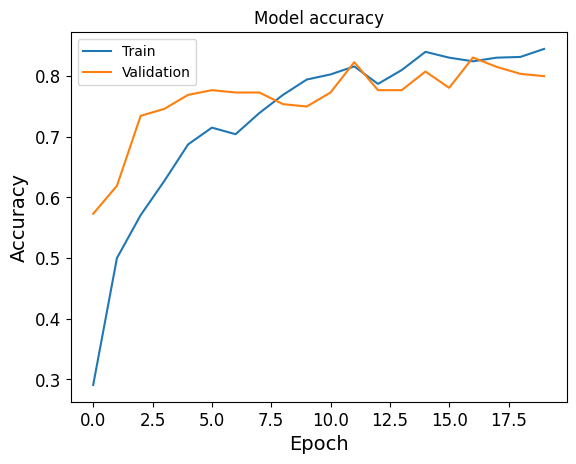

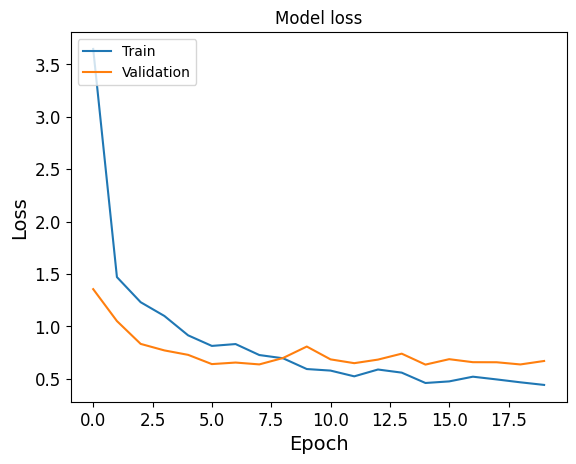

In [97]:
plot_history_scores(vgg_history)

## Inception

In [98]:
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.applications.inception_v3 import preprocess_input, decode_predictions
import numpy as np

# Load the InceptionV3 model
model = InceptionV3(weights='imagenet')


96112376/96112376 [==============================] - 6s 0us/step


In [99]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.applications import InceptionV3

# Load the pre-trained InceptionV3 model, excluding the top layer
base_model = InceptionV3(weights='imagenet')

# Create a new model on top
inception = Sequential()
inception.add(base_model)
#inception.add(GlobalAveragePooling2D())
inception.add(Flatten())

# Add a new fully connected layer for the output
inception.add(Dense(128, activation='relu', input_shape=inception.output_shape[1:]))
inception.add(Dropout(0.2))
inception.add(Dense(cat_number, activation='softmax'))
# Freeze the weights of the pre-trained layers
for layer in base_model.layers:
    layer.trainable = False


inception.compile(optimizer="adam",
                       loss="sparse_categorical_crossentropy",
                       metrics=["accuracy"])

In [100]:
from tensorflow.keras.applications.inception_v3 import preprocess_input

# Define data augmentation for the training data
inception_train_datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2,
    preprocessing_function=preprocess_input)

# Define the data generator for training data
inception_train = inception_train_datagen.flow( x_train,
                                               y_train,
                                               seed=42,
                                               batch_size=batch_size,
                                               subset='training')

# Define the data generator for validation data
inception_val = ImageDataGenerator(preprocessing_function=preprocess_input).flow(x_val,
                                                                                 y_val,
                                                                                 seed=42,
                                                                                 batch_size=batch_size)

# Define the data generator for test data
inception_test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
inception_test = inception_test_datagen.flow(X_test,
                                             Y_test,
                                             seed=42,
                                             batch_size=batch_size)


In [101]:
inception_history= inception.fit(inception_train,
                               validation_data=inception_val,
                               batch_size=batch_size,
                               validation_batch_size=batch_size,
                               epochs=20,
                               verbose=1)

Epoch 1/20
104/104 [==============================] - 22s 151ms/step - loss: 2.1891 - accuracy: 0.3990 - val_loss: 1.9776 - val_accuracy: 0.6231
Epoch 2/20
104/104 [==============================] - 14s 132ms/step - loss: 1.8465 - accuracy: 0.5721 - val_loss: 1.4354 - val_accuracy: 0.7231
Epoch 3/20
104/104 [==============================] - 14s 130ms/step - loss: 1.4284 - accuracy: 0.6454 - val_loss: 1.0332 - val_accuracy: 0.7538
Epoch 4/20
104/104 [==============================] - 14s 133ms/step - loss: 1.1965 - accuracy: 0.6851 - val_loss: 0.8484 - val_accuracy: 0.7692
Epoch 5/20
104/104 [==============================] - 14s 133ms/step - loss: 1.1332 - accuracy: 0.6647 - val_loss: 0.7801 - val_accuracy: 0.7692
Epoch 6/20
104/104 [==============================] - 14s 132ms/step - loss: 1.0646 - accuracy: 0.6851 - val_loss: 0.7327 - val_accuracy: 0.7731
Epoch 7/20
104/104 [==============================] - 14s 131ms/step - loss: 1.0178 - accuracy: 0.6983 - val_loss: 0.7047 - val_ac

In [102]:
# Evaluate the best model on the test data
train_loss_and_metrics_inception = inception.evaluate(train_generator, batch_size=batch_size)
loss_and_metrics_inception = inception.evaluate(test_generator, batch_size=batch_size)
print('Train accuracy:', train_loss_and_metrics_inception[1], 'Test accuracy:', loss_and_metrics_inception[1])

41/41 [==============================] - 2s 56ms/step - loss: 0.6364 - accuracy: 0.7975
Train accuracy: 0.7127403616905212 Test accuracy: 0.7975460290908813


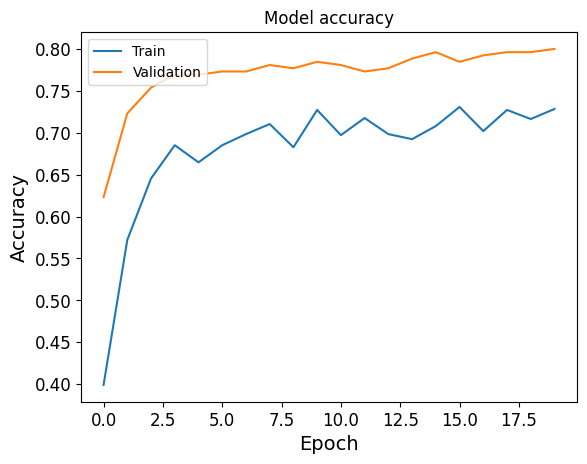

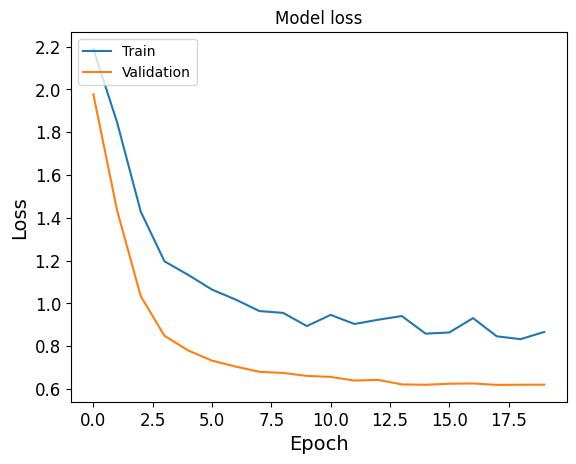

In [103]:
plot_history_scores(inception_history)

In [104]:
# Unfreeze some of the layers in the base model
for layer in base_model.layers[-20:]:
    layer.trainable = True

# Recompile the model with a lower learning rate
inception.compile(optimizer=keras.optimizers.Adam(learning_rate =0.00001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the entire model for more epochs
inception.fit(inception_train, epochs=20, validation_data=inception_val, verbose=1)

Epoch 1/20
104/104 [==============================] - 22s 144ms/step - loss: 1.0951 - accuracy: 0.6971 - val_loss: 0.5920 - val_accuracy: 0.7923
Epoch 2/20
104/104 [==============================] - 13s 130ms/step - loss: 0.9727 - accuracy: 0.7368 - val_loss: 0.5897 - val_accuracy: 0.7962
Epoch 3/20
104/104 [==============================] - 14s 131ms/step - loss: 0.9222 - accuracy: 0.7368 - val_loss: 0.5748 - val_accuracy: 0.8077
Epoch 4/20
104/104 [==============================] - 14s 130ms/step - loss: 0.8988 - accuracy: 0.7464 - val_loss: 0.5552 - val_accuracy: 0.8115
Epoch 5/20
104/104 [==============================] - 14s 132ms/step - loss: 0.8823 - accuracy: 0.7476 - val_loss: 0.5383 - val_accuracy: 0.8192
Epoch 6/20
104/104 [==============================] - 14s 136ms/step - loss: 0.8541 - accuracy: 0.7524 - val_loss: 0.5278 - val_accuracy: 0.8231
Epoch 7/20
104/104 [==============================] - 14s 133ms/step - loss: 0.7964 - accuracy: 0.7644 - val_loss: 0.5167 - val_ac

In [105]:
# Evaluate the best model on the test data
train_loss_and_metrics_inception = inception.evaluate(train_generator, batch_size=batch_size)
loss_and_metrics_inception = inception.evaluate(test_generator, batch_size=batch_size)
print('Train accuracy:', train_loss_and_metrics_inception[1], 'Test accuracy:', loss_and_metrics_inception[1])

41/41 [==============================] - 1s 31ms/step - loss: 0.4877 - accuracy: 0.8405
Train accuracy: 0.8137019276618958 Test accuracy: 0.8404908180236816


# Model Selection and fine tuning

## Model Selection

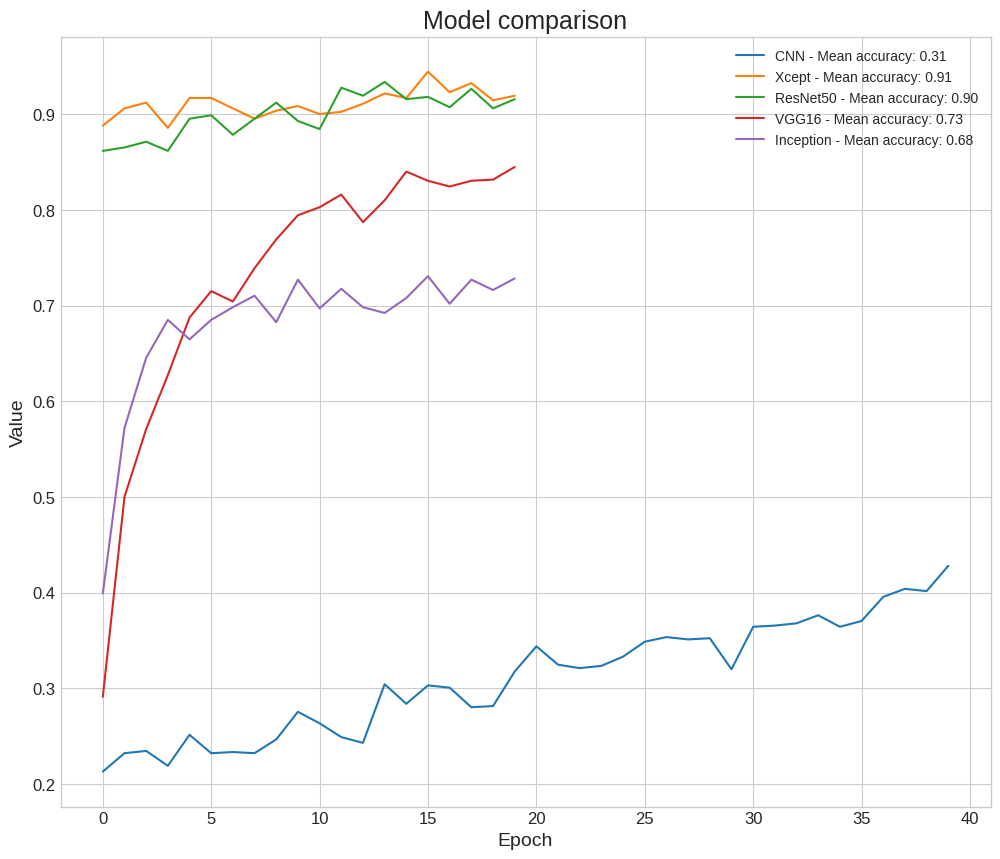

In [106]:
histories["VGG16"] = vgg_history
histories["Inception"] = inception_history
title = "Model comparison"
metrics = ["accuracy"]
compare_histories(histories= histories, metrics=metrics, title=title, figsize=figsize )

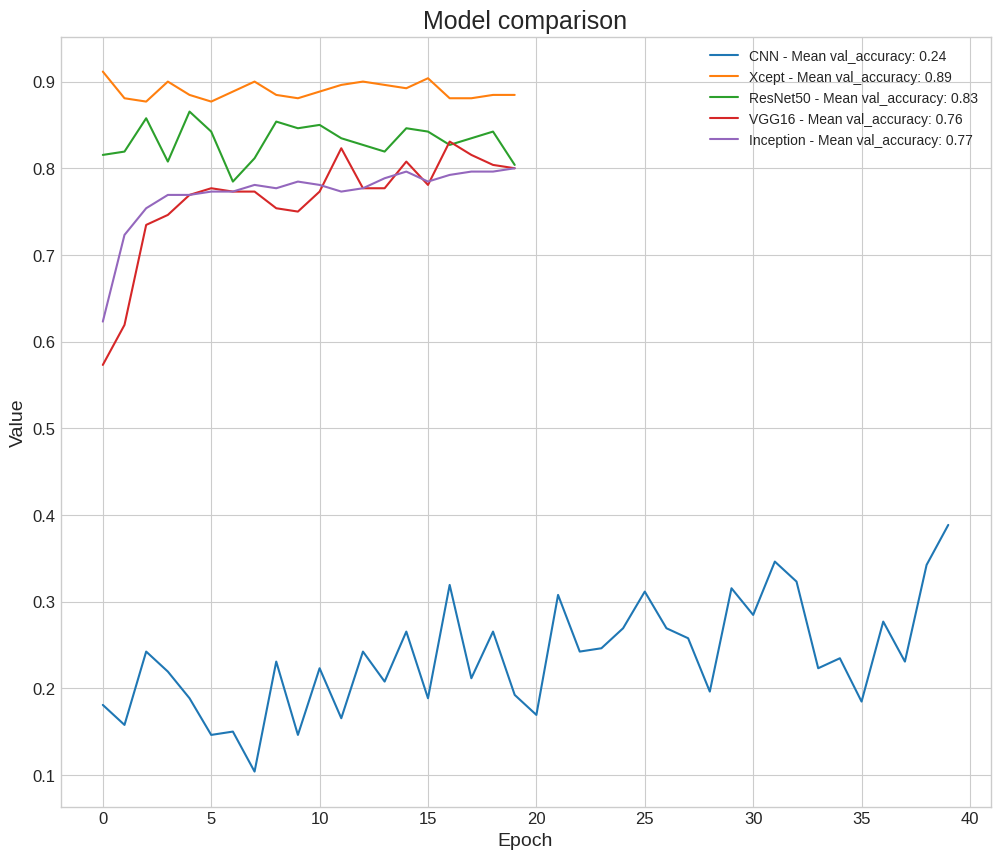

In [107]:
histories["VGG16"] = vgg_history
histories["Inception"] = inception_history
title = "Model comparison"
metrics = ["val_accuracy"]
compare_histories(histories= histories, metrics=metrics, title=title, figsize=figsize )

By analysing these, we can observe that Xception model and ResNet50 perform better.

Since the ResNet50 curve is highly volatile, we can say that its more instable for our dataset.

We select Xception model as the best which can perform better with our dataset.

In consequence, we will fine tune Xception.

In [108]:
from keras_tuner import HyperParameters
def model_builder(hp: HyperParameters) -> keras.models.Model:
    """
    Builds and compiles a CNN model using the Xception architecture with hyperparameters specified by the given 
    HyperParameters object.

    Args:
        hp (HyperParameters): A HyperParameters object containing the hyperparameters to use when building the model.

    Returns:
        A compiled Keras model using the Xception architecture with hyperparameters specified by the given 
        HyperParameters object.
    """
    # Load base model
    xception_model = tf.keras.applications.xception.Xception(
        weights='imagenet',
        include_top=False,
        pooling='avg',
        input_shape=input_shape)
    
    for layer in xception_model.layers:
        layer.trainable = False
    
    base_output = xception_model.output
    
    # Tune dense units
    hp_units = hp.Int('dense_units',
                      min_value=32,
                      max_value=300,
                      step=32,
                      default=128)
    hp_dropout = hp.Float('dropout', 
                          min_value=0.0, 
                          max_value=0.5, 
                          step=0.1, default=0.2)

    base_output = Dense(units=hp_units, 
                        activation='relu')(base_output)
    
    base_output = Dropout(hp_dropout)(base_output)
    
    # Output : new classifier
    predictions = Dense(cat_number, activation='softmax')(base_output)

    # Define new model
    xcept_model = Model(inputs=xception_model.input,
                       outputs=predictions)
    
    # Tune learning rate
    hp_learning_rate = hp.Choice(
        name='learning_rate',
        values=[1e-2, 1e-3, 1e-4])

    xcept_model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=hp_learning_rate),
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"])
    
    return xcept_model


In [109]:
# Define hyperparameter tuner
tuner = kt.Hyperband(model_builder,
                     objective='val_accuracy',
                     max_epochs=10,
                     factor=3,
                     directory='transfer_fine_tune',
                     project_name='model_tuning')

# Search for the best hyperparameters
tuner.search(train_generator,
             epochs=10,
             validation_data=val_generator)



Trial 30 Complete [00h 02m 29s]
val_accuracy: 0.8999999761581421

Best val_accuracy So Far: 0.9115384817123413
Total elapsed time: 00h 34m 50s


In [110]:
# Get the best model
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
best_model = model_builder(best_hps)
best_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 250, 250, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 124, 124, 32  864         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 124, 124, 32  128        ['block1_conv1[0][0]']           
 ation)                         )                                                           

In [111]:
print(best_hps.values)

{'dense_units': 64, 'dropout': 0.1, 'learning_rate': 0.001, 'tuner/epochs': 10, 'tuner/initial_epoch': 0, 'tuner/bracket': 0, 'tuner/round': 0}


In [112]:
best_model.fit(train_generator, 
               batch_size=batch_size,
               validation_batch_size=batch_size,
               epochs = 10,
             validation_data=val_generator)

Epoch 1/10
104/104 [==============================] - 18s 140ms/step - loss: 1.3812 - accuracy: 0.5589 - val_loss: 0.4760 - val_accuracy: 0.8769
Epoch 2/10
104/104 [==============================] - 14s 133ms/step - loss: 0.7677 - accuracy: 0.7500 - val_loss: 0.4289 - val_accuracy: 0.8462
Epoch 3/10
104/104 [==============================] - 14s 133ms/step - loss: 0.6421 - accuracy: 0.7873 - val_loss: 0.4382 - val_accuracy: 0.8692
Epoch 4/10
104/104 [==============================] - 15s 144ms/step - loss: 0.5977 - accuracy: 0.8101 - val_loss: 0.4082 - val_accuracy: 0.8654
Epoch 5/10
104/104 [==============================] - 14s 138ms/step - loss: 0.5141 - accuracy: 0.8197 - val_loss: 0.4092 - val_accuracy: 0.8615
Epoch 6/10
104/104 [==============================] - 14s 133ms/step - loss: 0.5118 - accuracy: 0.8305 - val_loss: 0.4476 - val_accuracy: 0.8731
Epoch 7/10
104/104 [==============================] - 14s 132ms/step - loss: 0.4557 - accuracy: 0.8353 - val_loss: 0.3487 - val_ac

In [113]:
best_model.save('/content/drive/MyDrive/Colab_Notebooks/model/best_model.h5')

In [114]:
best_model.evaluate(test_generator, batch_size=batch_size)

41/41 [==============================] - 2s 42ms/step - loss: 0.3548 - accuracy: 0.8865


[0.354767382144928, 0.8865030407905579]

In [115]:
def xception_fine_tune(nb_layers: int) -> keras.models.Model:
    """
    Builds and compiles a fine-tuned Xception model for image classification by freezing the first nb_layers layers
    of the base model and compiling the model with the Adam optimizer, sparse categorical crossentropy loss function,
    and accuracy metric.

    Args:
        nb_layers (int): The number of layers to freeze in the Xception model.

    Returns:
        A compiled Keras model for image classification.
    """
    # Load the Xception model
    opt_model = keras.models.load_model('/content/drive/MyDrive/Colab_Notebooks/model/best_model.h5')
    
    # Freeze the first nb_layers layers
    for layer in opt_model.layers[nb_layers:]:
        layer.trainable = True
   
    # Compile the model
    opt_model.compile(optimizer='adam',
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    
    return opt_model


In [116]:
# Define a early stopping
stop_early = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',
    patience=10)

# Dont train the 120 first layers
xcept_model_tuning = xception_fine_tune(150)
best_history = xcept_model_tuning.fit(
        train_generator, 
        batch_size=batch_size, 
        epochs=20,
        validation_data=val_generator,
        callbacks=[stop_early],
        verbose=1)

Epoch 1/20
104/104 [==============================] - 18s 142ms/step - loss: 0.4251 - accuracy: 0.8630 - val_loss: 0.3951 - val_accuracy: 0.8769
Epoch 2/20
104/104 [==============================] - 14s 133ms/step - loss: 0.3742 - accuracy: 0.8642 - val_loss: 0.4430 - val_accuracy: 0.8692
Epoch 3/20
104/104 [==============================] - 14s 133ms/step - loss: 0.3400 - accuracy: 0.8774 - val_loss: 0.4586 - val_accuracy: 0.8731
Epoch 4/20
104/104 [==============================] - 14s 134ms/step - loss: 0.3772 - accuracy: 0.8678 - val_loss: 0.3946 - val_accuracy: 0.8846
Epoch 5/20
104/104 [==============================] - 14s 132ms/step - loss: 0.2992 - accuracy: 0.8954 - val_loss: 0.4035 - val_accuracy: 0.8692
Epoch 6/20
104/104 [==============================] - 14s 133ms/step - loss: 0.3722 - accuracy: 0.8738 - val_loss: 0.4221 - val_accuracy: 0.8615
Epoch 7/20
104/104 [==============================] - 14s 131ms/step - loss: 0.3224 - accuracy: 0.8930 - val_loss: 0.4082 - val_ac

In [117]:
# Model evaluation on test set
test_score = best_history.model.evaluate(
    test_generator,batch_size=batch_size,
    verbose=1)

train_score = best_history.model.evaluate(
    train_generator,
    verbose=1, batch_size=batch_size)
print("-" * 50)
print("Xception model evaluation :")
print("-" * 50)
print('Train Loss: {} Test loss:{}'.format(train_score[0], test_score[0]))
print('Train Accuracy: {} Test  Accuracy: {}'.format(train_score[1], test_score[1]))

104/104 [==============================] - 13s 121ms/step - loss: 0.1878 - accuracy: 0.9387
--------------------------------------------------
Xception model evaluation :
--------------------------------------------------
Train Loss: 0.18778985738754272 Test loss:0.387555867433548
Train Accuracy: 0.9387019276618958 Test  Accuracy: 0.8926380276679993


## Prediction and metrics visualization

41/41 [==============================] - 2s 41ms/step


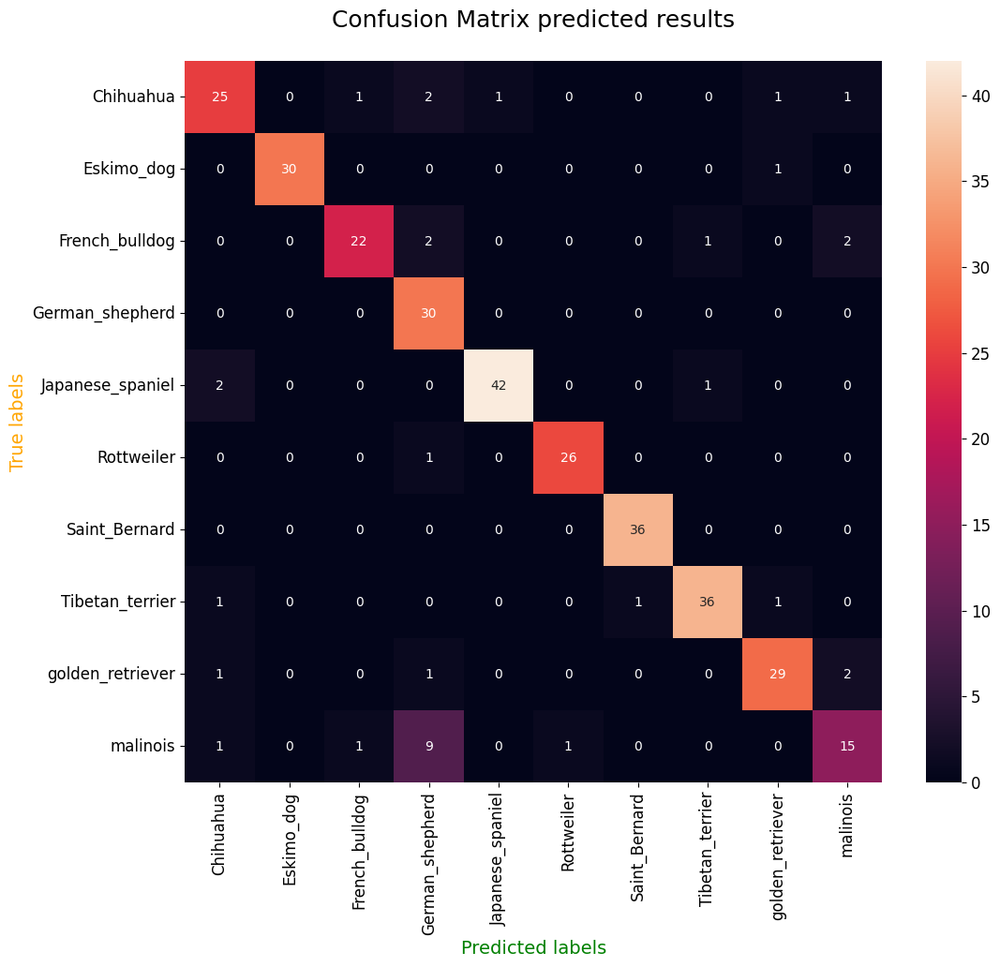

In [118]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
# Make predictions
Y_pred = best_history.model.predict(
    test_generator, batch_size=batch_size)
y_pred = np.argmax(Y_pred, axis=1)

# Inverse transform of encoding
y_pred_s = label_encoder.inverse_transform(y_pred)
y_test_s = label_encoder.inverse_transform(Y_test)

# Confusion Matrix
cf_matrix = confusion_matrix(Y_test, y_pred)

fig = plt.figure(figsize=(12,10))
ax = sns.heatmap(cf_matrix, annot=True)
ax.set_xlabel("Predicted labels", color="g")
ax.set_ylabel("True labels", color="orange")
ax.xaxis.set_ticklabels(label_encoder.classes_, 
                        rotation='vertical')
ax.yaxis.set_ticklabels(label_encoder.classes_,
                        rotation='horizontal')
plt.title("Confusion Matrix predicted results\n",
          fontsize=18)
plt.savefig('best_model_confusion.png')
plt.show()

In [119]:
from sklearn.metrics import classification_report
# Classification report
report = classification_report(Y_test, y_pred,
                               target_names=sorted(set(y_test_s)))
print(report)

                  precision    recall  f1-score   support

       Chihuahua       0.83      0.81      0.82        31
      Eskimo_dog       1.00      0.97      0.98        31
  French_bulldog       0.92      0.81      0.86        27
 German_shepherd       0.67      1.00      0.80        30
Japanese_spaniel       0.98      0.93      0.95        45
      Rottweiler       0.96      0.96      0.96        27
   Saint_Bernard       0.97      1.00      0.99        36
 Tibetan_terrier       0.95      0.92      0.94        39
golden_retriever       0.91      0.88      0.89        33
        malinois       0.75      0.56      0.64        27

        accuracy                           0.89       326
       macro avg       0.89      0.88      0.88       326
    weighted avg       0.90      0.89      0.89       326



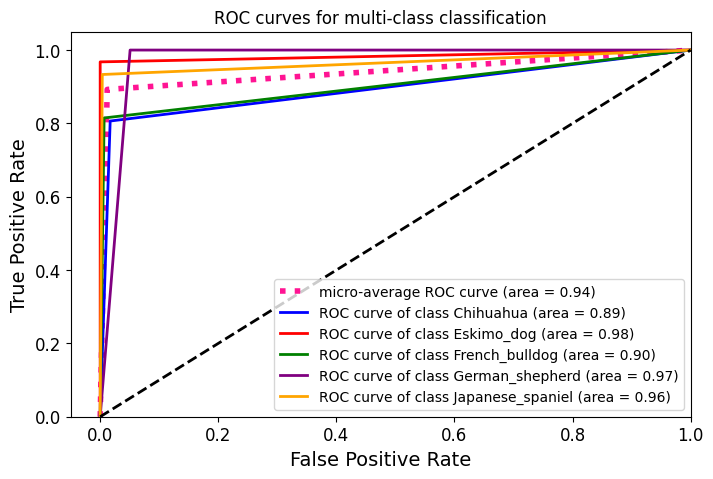

In [120]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score, roc_curve
from tensorflow.keras.models import load_model


# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
# convert Y_test to one-hot encoded matrix
Y_test_encoded = to_categorical(Y_test)
Y_pred_encoded = to_categorical(y_pred)
class_names = label_encoder.classes_
# get number of classes
n_classes = Y_test_encoded.shape[1]
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_test_encoded[:, i], Y_pred_encoded[:, i])
    roc_auc[i] = roc_auc_score(Y_test_encoded[:, i], Y_pred_encoded[:, i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(Y_test_encoded.ravel(), Y_pred_encoded.ravel())
roc_auc["micro"] = roc_auc_score(Y_test_encoded, Y_pred_encoded, multi_class="ovr", average="micro")

# Plot ROC curves for all classes and micro-average
plt.figure(figsize=(8, 5))
plt.plot(fpr["micro"], tpr["micro"], label='micro-average ROC curve (area = {0:0.2f})'
         ''.format(roc_auc["micro"]), color='deeppink', linestyle=':', linewidth=4)
colors = ['blue', 'red', 'green', 'purple', 'orange']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(class_names[i],  roc_auc[i]))
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves for multi-class classification')
plt.legend(loc="lower right")
plt.savefig('roc_curve.png')
plt.show()


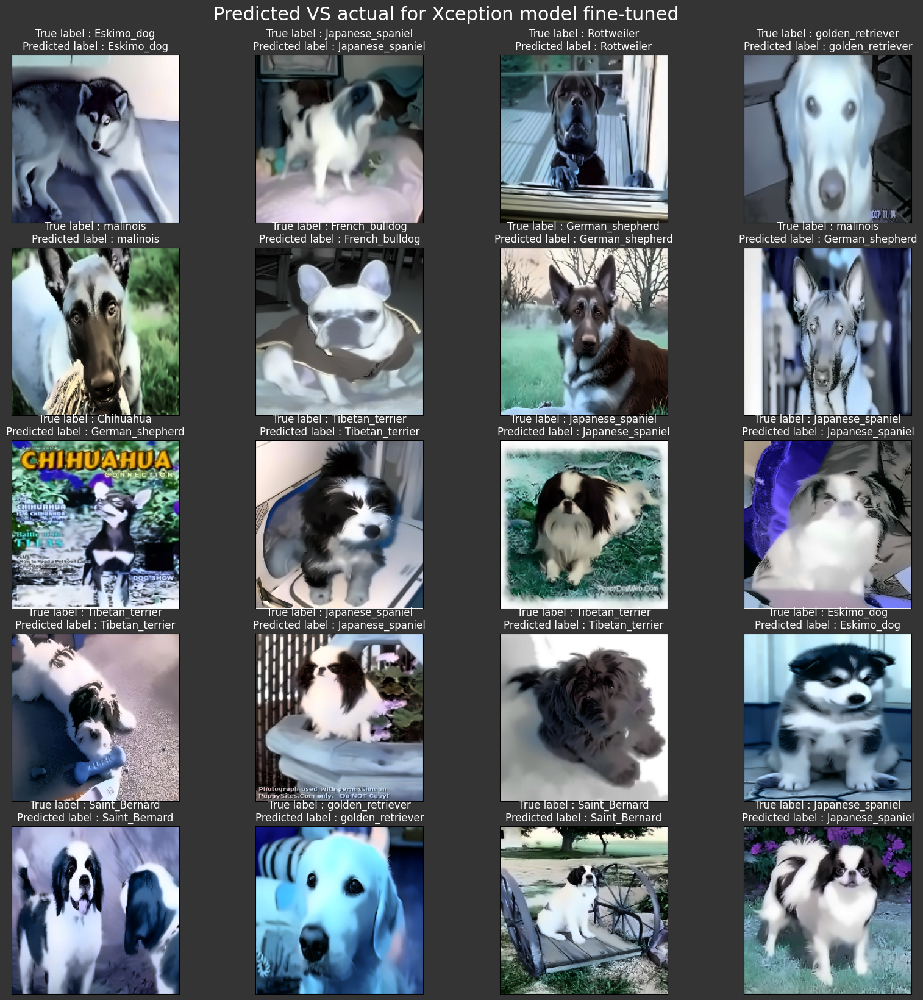

In [121]:
fig = plt.figure(1, figsize=(20,20))
fig.patch.set_facecolor('#343434')
plt.suptitle("Predicted VS actual for Xception model fine-tuned",
             y=.92, fontsize=22,
             color="white")

n = 0

for i in range(20):
    n+=1
    r = int(np.random.randint(0, X_test.shape[0], 1))
    plt.subplot(5,4,n)
    plt.subplots_adjust(hspace = 0.15, wspace = 0.15)
    plt.imshow(keras.preprocessing.image.array_to_img(X_test[r]))
    plt.title('True label : {}\nPredicted label : {}'.format(y_test_s[r] , y_pred_s[r]),
              color="white")
    plt.xticks([]) , plt.yticks([])
plt.savefig('predicted vs true.png')  
plt.show()

# Machine Learning Demo

In [122]:
# Save the last model
best_history.model.save('/content/drive/MyDrive/Colab_Notebooks/model/optimal_model.h5')

In [123]:
import pickle
with open('/content/drive/MyDrive/Colab_Notebooks/model/label_encoder.pkl', 'wb') as f:
    pickle.dump(label_encoder, f)

In [124]:
import gradio as gr
import cv2
import tensorflow as tf
from tensorflow import keras
from typing import Dict

# Load the pre-trained model
model = keras.models.load_model('/content/drive/MyDrive/Colab_Notebooks/model/optimal_model.h5')
cat_number = 4  # Change this to the number of output classes in your model

def dog_class_prediction(inp: np.ndarray) -> Dict[str, float]:
    """
    A function that takes an input image of a dog and returns the predicted breed with a probability score.

    Parameters:
    inp (numpy.ndarray): A numpy array representing the input image of a dog.

    Returns:
    dict: A dictionary containing the predicted dog breed as keys and the corresponding probability score as values.
    """

    # Convert input image to RGB
    img = cv2.cvtColor(inp, cv2.COLOR_BGR2RGB)

    # Resize image
    dim = (250, 250)
    img = cv2.resize(img, dim, interpolation=cv2.INTER_LINEAR)

    # Perform histogram equalization on the image
    img_yuv = cv2.cvtColor(img,cv2.COLOR_BGR2YUV)
    img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0])
    img_equ = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)

    # Apply non-local means filter on test image
    dst_img = cv2.fastNlMeansDenoisingColored(
        src=img_equ,
        dst=None,
        h=10,
        hColor=10,
        templateWindowSize=7,
        searchWindowSize=21)

    # Convert the modified image to a numpy array
    img_array = keras.preprocessing.image.img_to_array(dst_img)

    # Apply preprocess Xception
    img_array = img_array.reshape((-1, 250, 250, 3))
    img_array = tf.keras.applications.xception.preprocess_input(img_array)

    # Make a prediction
    prediction = model.predict(img_array).flatten()

    # Create a dictionary with the predicted dog breed and the corresponding probability score
    result = {label_encoder.classes_[i]: float(prediction[i]) for i in range(cat_number)}

    return result



In [125]:
# Create the user interface using Gradio
image = gr.inputs.Image()
label = gr.outputs.Label(num_top_classes=4)

gr.Interface( fn=dog_class_prediction,
             inputs=image,
             outputs=label,
             capture_session=True).launch(share=True, debug=False)

/usr/local/lib/python3.10/dist-packages/gradio/inputs.py:259: UserWarning: Usage of gradio.inputs is deprecated, and will not be supported in the future, please import your component from gradio.components
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gradio/deprecation.py:40: UserWarning: `optional` parameter is deprecated, and it has no effect
  warnings.warn(value)
/usr/local/lib/python3.10/dist-packages/gradio/outputs.py:197: UserWarning: Usage of gradio.outputs is deprecated, and will not be supported in the future, please import your components from gradio.components
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gradio/deprecation.py:40: UserWarning: The 'type' parameter has been deprecated. Use the Number component instead.
  warnings.warn(value)
/usr/local/lib/python3.10/dist-packages/gradio/deprecation.py:40: UserWarning: `capture_session` parameter is deprecated, and it has no effect
  warnings.warn(value)


Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://1d1e3a64670d78612e.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades (NEW!), check out Spaces: https://huggingface.co/spaces


In [ ]:
import streamlit as st
import cv2
import numpy as np
import tensorflow as tf
from tensorflow import keras
import gradio as gr

# Load the pre-trained model
model = keras.models.load_model('/content/drive/MyDrive/Colab_Notebooks/model/optimal_model.h5')

def dog_class_prediction(inp: np.ndarray) -> dict:
    """
    A function that takes an input image of a dog and returns the predicted breed with a probability score.

    Parameters:
    inp (numpy.ndarray): A numpy array representing the input image of a dog.

    Returns:
    dict: A dictionary containing the predicted dog breed as keys and the corresponding probability score as values.
    """

    # Convert input image to RGB
    img = cv2.cvtColor(inp, cv2.COLOR_BGR2RGB)

    # Resize image
    dim = (250, 250)
    img = cv2.resize(img, dim, interpolation=cv2.INTER_LINEAR)

    # Perform histogram equalization on the image
    img_yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
    img_yuv[:, :, 0] = cv2.equalizeHist(img_yuv[:, :, 0])
    img_equ = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)

    # Apply non-local means filter on test image
    dst_img = cv2.fastNlMeansDenoisingColored(
        src=img_equ,
        dst=None,
        h=10,
        hColor=10,
        templateWindowSize=7,
        searchWindowSize=21)

    # Convert the modified image to a numpy array
    img_array = keras.preprocessing.image.img_to_array(dst_img)

    # Apply preprocess Xception
    img_array = img_array.reshape((-1, 250, 250, 3))
    img_array = tf.keras.applications.xception.preprocess_input(img_array)

    # Make a prediction
    prediction = model.predict(img_array).flatten()

    # Get the label encoder from the model
    label_encoder = model.get_layer('label_encoder')

    # Create a dictionary with the predicted dog breed and the corresponding probability score
    result = {label_encoder.classes_[i]: float(prediction[i]) for i in range(len(label_encoder.classes_))}

    return result

def main():
    st.title("Dog Breed Classification")

    # Create an interface using Gradio
    image = gr.inputs.Image()
    label = gr.outputs.Label(num_top_classes=4)
    interface = gr.Interface(
        fn=dog_class_prediction,
        inputs=image,
        outputs=label,
        capture_session=True
    )

    # Launch the Streamlit app
    st.sidebar.title("Dog Breed Classifier")
    st.sidebar.write("Upload an image of a dog to classify its breed.")
    uploaded_file = st.sidebar.file_uploader("Upload Image", type=["jpg", "jpeg", "png"])
    if uploaded_file is not None:
        # Read the uploaded image
        file_bytes = np.asarray(bytearray(uploaded_file.read()), dtype=np.uint8)
        image = cv2.imdecode(file_bytes, 1)

        # Display the uploaded image
        st.image(image, channels="BGR", use_column_width=True)

        # Make a prediction using Gradio interface
        prediction = interface.process(image)

        # Display the predicted dog breeds and probability scores
        st.subheader("Predictions:")
        for breed, score in prediction.items():
            st.write(f"- {breed}: {score:.4f}")

if __name__ == "__main__":
    main()


# Conclusion


*  The transfer learning model perform better than a simple CNN Model.
*   There is some overfitting, which mean that we can increase the optimizing parameter or perform another data augmentation


*   The overfitting in Transfer learning can be explain by the complexity of the these model
*   The Overfitting of standard CNN is due to lenght of our data. Since we need little categories numbers to test many technique of deep learning classification, data augmentation is not sufficient to deal with the overfitting problem




**Author**

*Adonija ZIO*

